# BatikSnap's Batik Pattern Image Classification

This notebook contains neural network modeling using TensorFlow for batik pattern classification for Bangkit 2023 capstone project of group C23-PR498.

We start by loading our data in the [Preprocessing section](#scrollTo=Preprocessing) then create data generator in the [Create Data Generator and Augmentation section](#scrollTo=Create_Data_Generator_and_Augmentation). There are several modelling approach that we do here which is model from scratch and transfer learning.

Model from scratch is attempting to create a model by ourself with Sequential and other TensorFlow layers in the [Implement TF Model from Scratch section](#scrollTo=Implement_TF_Model_from_Scratch). Next, we tried to do several transfer learning with InceptionV3 and MobileNetV2 in the [Implement Transfer Learning 1 - InceptionV3 (non-trainable) section](#scrollTo=Implement_Transfer_Learning_1_InceptionV3_non_trainable_), [Implement Transfer Learning 2 - InceptionV3 (partially trainable)](#scrollTo=Implement_Transfer_Learning_2_InceptionV3_partially_trainable_), [Implement Transfer Learning 3 - MobileNetV2](#scrollTo=Implement_Transfer_Learning_3_MobileNetV2), and [Implement Transfer Learning 4 - MobileNet](#scrollTo=Implement_Transfer_Learning_4_MobileNet).

There are seven patterns to be recognized:

1.   Insang
2.   Kawung
3.   Mega mendung
4.   Parang
5.   Sidoluhur
6.   Truntum
7.   Tumpal

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import random
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as img
import tensorflow as tf
from shutil import copyfile, rmtree, copytree
from sklearn.metrics import confusion_matrix
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img

# Preprocessing
Choose between **Train-val split** or **Train-val-test split**. Only run train-val split OR train-val-test split.

**Train-val split**       : Split randomly for train and val set. Test set is loaded from pre-defined directory (This is what we mostly use).

**Train-val-test split**  : Use pre-split set of train, val, and test.

## Load source data

In [2]:
%cd '/content/drive/My Drive/Capstone C23-PR498/ML'
!ls

/content/drive/My Drive/Capstone C23-PR498/ML
 batikimages   batikimages_2   BatikSnap.ipynb	'Saved model'


In [ ]:
SOURCE_DIR = 'batikimages'
class_name = ['Insang', 'Kawung', 'Mega mendung', 'Parang', 'Sidoluhur', 'Truntum', 'Tumpal']
for i in range(len(class_name)):
  print('Total gambar Batik ' + class_name[i] + ":", len(os.listdir(os.path.join(SOURCE_DIR, class_name[i]))))

Total gambar Batik Insang: 138
Total gambar Batik Kawung: 288
Total gambar Batik Mega mendung: 320
Total gambar Batik Parang: 269
Total gambar Batik Sidoluhur: 102
Total gambar Batik Truntum: 212
Total gambar Batik Tumpal: 107


## Train-val split

### Create train val directory

In [ ]:
# Define root directory
root_dir = '/tmp/batikimages'
batik_name = ["Insang", "Kawung", "Mega mendung", "Parang", "Sidoluhur", "Truntum", "Tumpal"]

# Empty directory to prevent FileExistsError is the function is run several times
if os.path.exists(root_dir):
  rmtree(root_dir)

def create_train_val_dirs(root_path):
  """
  Creates directories for the train and val sets

  Args:
    root_path (string) - the base directory path to create subdirectories from

  Returns:
    None
  """

  train_dirs = os.path.join(root_path, 'training')
  validation_dirs = os.path.join(root_path, 'validation')

  for batik in batik_name :
    os.makedirs(os.path.join(train_dirs, batik))
    os.makedirs(os.path.join(validation_dirs, batik))


In [ ]:
# Create folders for storing the data
try:
  create_train_val_dirs(root_path=root_dir)
except FileExistsError:
  print("You should not be seeing this since the upper directory is removed beforehand")

for rootdir, dirs, files in os.walk(root_dir):
    for subdir in dirs:
        print(os.path.join(rootdir, subdir))

/tmp/batikimages/validation
/tmp/batikimages/training
/tmp/batikimages/validation/Truntum
/tmp/batikimages/validation/Kawung
/tmp/batikimages/validation/Parang
/tmp/batikimages/validation/Tumpal
/tmp/batikimages/validation/Sidoluhur
/tmp/batikimages/validation/Insang
/tmp/batikimages/validation/Mega mendung
/tmp/batikimages/training/Truntum
/tmp/batikimages/training/Kawung
/tmp/batikimages/training/Parang
/tmp/batikimages/training/Tumpal
/tmp/batikimages/training/Sidoluhur
/tmp/batikimages/training/Insang
/tmp/batikimages/training/Mega mendung


### Randomize and split data (train-val)

In [ ]:
def split_data(SOURCE_DIR, TRAINING_DIR, VALIDATION_DIR, SPLIT_SIZE, SAMPLE_SIZE):
  """
  Splits the data into train and validation sets

  Args:
    SOURCE_DIR (string): directory path containing the images
    TRAINING_DIR (string): directory path to be used for training
    VALIDATION_DIR (string): directory path to be used for validation
    SPLIT_SIZE (float): proportion of the dataset to be used for training
    SAMPLE_SIZE (int): total amount of data to be splited

  Returns:
    None
  """
  source_files = []
  for f in os.listdir(SOURCE_DIR):
    if os.path.getsize(os.path.join(SOURCE_DIR,f)) > 0:
      source_files.append(f)
    else:
      print(f'{f} is zero length, so ignoring.')

  shuffled_files = random.sample(source_files, SAMPLE_SIZE)
  training_length = int(SPLIT_SIZE * len(shuffled_files))

  for train in shuffled_files[:training_length]:
    copyfile(os.path.join(SOURCE_DIR, train), os.path.join(TRAINING_DIR, train))

  for val in shuffled_files[training_length:]:
    copyfile(os.path.join(SOURCE_DIR, val), os.path.join(VALIDATION_DIR, val))

In [ ]:
# Define paths
SOURCE_DIR = 'batikimages'
CLASS_SOURCE_LIST_DIR = [os.path.join(SOURCE_DIR, class_dir) for class_dir in batik_name]
print(f'CLASS_SOURCE_DIR : {CLASS_SOURCE_LIST_DIR}')

TRAINING_DIR = "/tmp/batikimages/training/"
TRAINING_LIST_DIR = [os.path.join(TRAINING_DIR, class_dir) for class_dir in batik_name]
print(f'TRAINING_LIST_DIR : {TRAINING_LIST_DIR}')

VALIDATION_DIR = "/tmp/batikimages/validation/"
VALIDATION_LIST_DIR = [os.path.join(VALIDATION_DIR, class_dir) for class_dir in batik_name]
print(f'VALIDATION_LIST_DIR : {VALIDATION_LIST_DIR}')

CLASS_SOURCE_DIR : ['batikimages/Insang', 'batikimages/Kawung', 'batikimages/Mega mendung', 'batikimages/Parang', 'batikimages/Sidoluhur', 'batikimages/Truntum', 'batikimages/Tumpal']
TRAINING_LIST_DIR : ['/tmp/batikimages/training/Insang', '/tmp/batikimages/training/Kawung', '/tmp/batikimages/training/Mega mendung', '/tmp/batikimages/training/Parang', '/tmp/batikimages/training/Sidoluhur', '/tmp/batikimages/training/Truntum', '/tmp/batikimages/training/Tumpal']
VALIDATION_LIST_DIR : ['/tmp/batikimages/validation/Insang', '/tmp/batikimages/validation/Kawung', '/tmp/batikimages/validation/Mega mendung', '/tmp/batikimages/validation/Parang', '/tmp/batikimages/validation/Sidoluhur', '/tmp/batikimages/validation/Truntum', '/tmp/batikimages/validation/Tumpal']


In [ ]:
# SPLIT DATA

# Empty directories in case you run this cell multiple times
for temp in TRAINING_LIST_DIR:
  if len(os.listdir(temp)) > 0:
    for file in os.scandir(temp):
      os.remove(file.path)

for temp in VALIDATION_LIST_DIR:
  if len(os.listdir(temp)) > 0:
    for file in os.scandir(temp):
      os.remove(file.path)

# Define proportion of images used for training
SPLIT_SIZE = .8
# Define amount of total image to be loaded (train + validation)
SAMPLE_SIZE = 100

# Run the function
for i in range(len(CLASS_SOURCE_LIST_DIR)):
  split_data(CLASS_SOURCE_LIST_DIR[i], TRAINING_LIST_DIR[i], VALIDATION_LIST_DIR[i], SPLIT_SIZE, SAMPLE_SIZE)

  # Your function should perform copies rather than moving images so original directories should contain unchanged images
  print(f"\n\nOriginal Batik {os.listdir(SOURCE_DIR)[i]}'s directory has {len(os.listdir(CLASS_SOURCE_LIST_DIR[i]))} images")

  # Training and validation splits. Check that the number of images matches the expected output.
  print(f"There are {len(os.listdir(TRAINING_LIST_DIR[i]))} images of Batik {os.listdir(SOURCE_DIR)[i]} for training")
  print(f"There are {len(os.listdir(VALIDATION_LIST_DIR[i]))} images of Batik {os.listdir(SOURCE_DIR)[i]} for validation")



Original Batik Mega mendung's directory has 138 images
There are 80 images of Batik Mega mendung for training
There are 20 images of Batik Mega mendung for validation


Original Batik Insang's directory has 288 images
There are 80 images of Batik Insang for training
There are 20 images of Batik Insang for validation


Original Batik Truntum's directory has 320 images
There are 80 images of Batik Truntum for training
There are 20 images of Batik Truntum for validation


Original Batik Kawung's directory has 269 images
There are 80 images of Batik Kawung for training
There are 20 images of Batik Kawung for validation


Original Batik Parang's directory has 102 images
There are 80 images of Batik Parang for training
There are 20 images of Batik Parang for validation


Original Batik Tumpal's directory has 212 images
There are 80 images of Batik Tumpal for training
There are 20 images of Batik Tumpal for validation


Original Batik Sidoluhur's directory has 107 images
There are 80 images

### Load test data

In [ ]:
TEST_SOURCE = os.path.join("batikimages_2", "test")
TEST_DIR = os.path.join(root_dir, "test")
copytree(TEST_SOURCE, TEST_DIR)

'/tmp/batikimages/test'

## Train-val-test split

### Copy train-val-test data

In [ ]:
# Define paths
root_dir = '/tmp/batikimages'
SPLITTED_SOURCE_DIR = "batikimages_2"
print(f'SPLITTED_SOURCE_DIR : {SPLITTED_SOURCE_DIR}')

TRAINING_DIR = "/tmp/batikimages/training/"
print(f'TRAINING_DIR : {TRAINING_DIR}')

VALIDATION_DIR = "/tmp/batikimages/validation/"
print(f'VALIDATION_DIR : {VALIDATION_DIR}')

TEST_DIR = "/tmp/batikimages/test/"
print(f'TEST_DIR : {TEST_DIR}')

SPLITTED_SOURCE_DIR : batikimages_2
TRAINING_DIR : /tmp/batikimages/training/
VALIDATION_DIR : /tmp/batikimages/validation/
TEST_DIR : /tmp/batikimages/test/


In [ ]:
# COPY DATA
copytree(SPLITTED_SOURCE_DIR, root_dir)

'/tmp/batikimages'

# Create Data Generator and Augmentation

In [ ]:
TRAINING_DIR = "/tmp/batikimages/training/"
VALIDATION_DIR = "/tmp/batikimages/validation/"
TEST_DIR = "/tmp/batikimages/test/"

print(f"Flowing training data from {TRAINING_DIR}")
print(f"Flowing validation data from {VALIDATION_DIR}")
print()

train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=25,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.25,
    zoom_range=0.25,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2],
    fill_mode='constant'
    )

train_generator = train_datagen.flow_from_directory(
    directory=TRAINING_DIR,
    target_size=(224,224),
    class_mode='categorical',
    batch_size=10,
    color_mode='rgb'
)

val_datagen = ImageDataGenerator(
    rescale=1./255)

val_generator = val_datagen.flow_from_directory(
    directory=VALIDATION_DIR,
    target_size=(224,224),
    class_mode='categorical',
    batch_size=10,
    color_mode='rgb'
)

Flowing training data from /tmp/batikimages/training/
Flowing validation data from /tmp/batikimages/validation/

Found 560 images belonging to 7 classes.
Found 140 images belonging to 7 classes.


In [ ]:
motives_dict = train_generator.class_indices
motives_list = list(train_generator.class_indices)
NUM_CLASSES = len(motives_dict)
print(motives_dict)
print(f"Number of classes: {NUM_CLASSES}")

{'Insang': 0, 'Kawung': 1, 'Mega mendung': 2, 'Parang': 3, 'Sidoluhur': 4, 'Truntum': 5, 'Tumpal': 6}
Number of classes: 7


## Display augmented samples

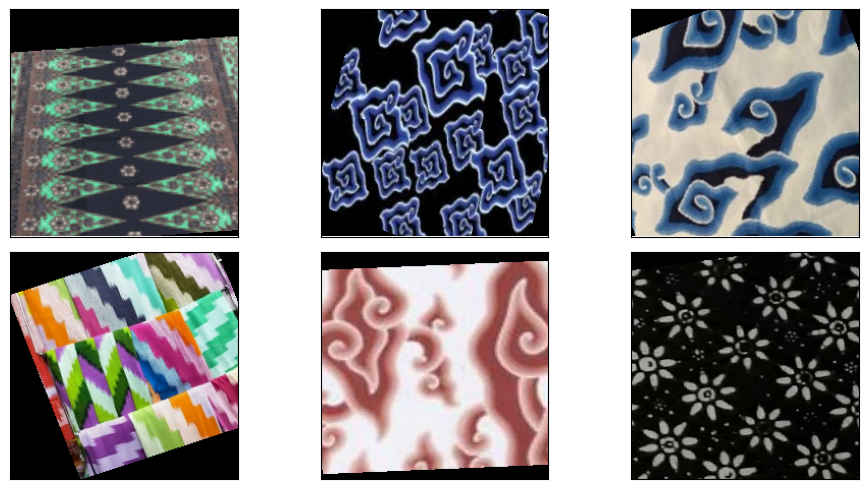

In [ ]:
plt.figure(figsize=(10,5))
for i in range(6):
  plt.subplot(2,3,i+1)
  for x in train_generator:
    plt.imshow(x[0][3])
    plt.xticks([])
    plt.yticks([])
    break
plt.tight_layout()
plt.show()

# Implement TF Model from Scratch

## Define model

In [ ]:
model_1 = tf.keras.models.Sequential([
   tf.keras.layers.Conv2D(64, (3,3), activation='relu', input_shape=(224,224,3)),
   tf.keras.layers.MaxPooling2D(2,2),
   tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
   tf.keras.layers.MaxPooling2D(2,2),
   tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
   tf.keras.layers.MaxPooling2D(2,2),
   tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
   tf.keras.layers.MaxPooling2D(2,2),
   tf.keras.layers.Flatten(),
   tf.keras.layers.Dropout(0.5),
   tf.keras.layers.Dense(210, activation='relu'),
   tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

model_1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_98 (Conv2D)          (None, 222, 222, 64)      1792      
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 111, 111, 64)     0         
 2D)                                                             
                                                                 
 conv2d_99 (Conv2D)          (None, 109, 109, 64)      36928     
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 conv2d_100 (Conv2D)         (None, 52, 52, 128)       73856     
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 26, 26, 128)     

## Define callback - lr scheduler

In [ ]:
def scheduler(epoch, lr):
  DECAY_RATE = 0.1
  DECAY_STEP = 5
  if epoch % DECAY_STEP == 0:
    return lr * tf.math.exp(-DECAY_RATE)
  else:
    return lr

lr_callback = tf.keras.callbacks.LearningRateScheduler(scheduler)

## Training

In [ ]:
model_1.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics=['accuracy'])
history_1 = model_1.fit(train_generator,
                      epochs=50,
                      validation_data = val_generator,
                      verbose = 1,
                      callbacks=lr_callback)

Epoch 1/50
56/56 [==============================] - 14s 167ms/step - loss: 1.9574 - accuracy: 0.1464 - val_loss: 1.9285 - val_accuracy: 0.2000 - lr: 9.0484e-04
Epoch 2/50
56/56 [==============================] - 10s 181ms/step - loss: 1.9149 - accuracy: 0.1518 - val_loss: 1.8744 - val_accuracy: 0.2000 - lr: 9.0484e-04
Epoch 3/50
56/56 [==============================] - 10s 166ms/step - loss: 1.8873 - accuracy: 0.2000 - val_loss: 1.8500 - val_accuracy: 0.2000 - lr: 9.0484e-04
Epoch 4/50
56/56 [==============================] - 10s 183ms/step - loss: 1.8908 - accuracy: 0.1786 - val_loss: 1.8966 - val_accuracy: 0.1929 - lr: 9.0484e-04
Epoch 5/50
56/56 [==============================] - 10s 170ms/step - loss: 1.8378 - accuracy: 0.2536 - val_loss: 1.7843 - val_accuracy: 0.2071 - lr: 9.0484e-04
Epoch 6/50
56/56 [==============================] - 8s 146ms/step - loss: 1.7684 - accuracy: 0.2786 - val_loss: 1.7727 - val_accuracy: 0.2857 - lr: 8.1873e-04
Epoch 7/50
56/56 [=======================

## Plotting

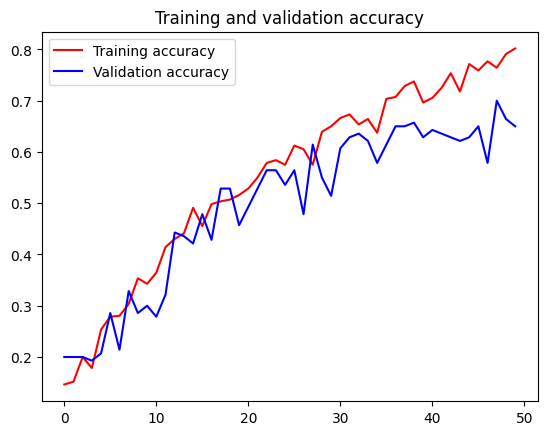

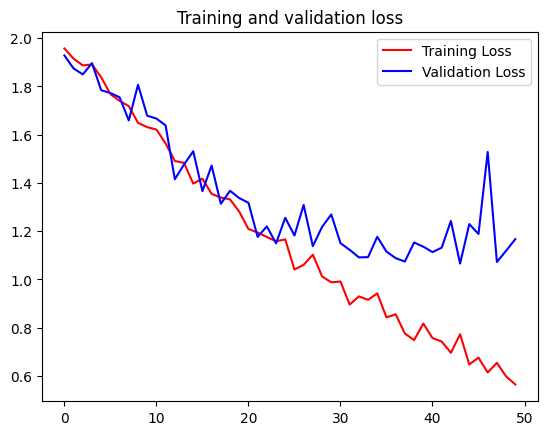

In [ ]:
# Plot the chart for accuracy and loss on both training and validation
acc = history_1.history['accuracy']
val_acc = history_1.history['val_accuracy']
loss = history_1.history['loss']
val_loss = history_1.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# Implement Transfer Learning 1 - InceptionV3 (non-trainable)

## Import and download transfer learning module

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3

In [ ]:
!wget --no-check-certificate \
    https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5 \
    -O /tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5

--2023-06-14 06:54:54--  https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5
Resolving storage.googleapis.com (storage.googleapis.com)... 209.85.200.128, 209.85.234.128, 142.251.171.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|209.85.200.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 87910968 (84M) [application/x-hdf]
Saving to: ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’

/tmp/inception_v3_w 100%[===================>]  83.84M  98.6MB/s    in 0.9s    

2023-06-14 06:54:55 (98.6 MB/s) - ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’ saved [87910968/87910968]



## Define non-trainable pre-trained model

In [ ]:
local_weights_file = '/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5'

def create_pre_trained_model(local_weights_file):
  """
  Initializes an InceptionV3 model.

  Args:
    local_weights_file (string): path pointing to a pretrained weights H5 file

  Returns:
    pre_trained_model: the initialized InceptionV3 model
  """

  pre_trained_model = InceptionV3(input_shape = (224, 224, 3),
                                  include_top = False,
                                  weights = None)

  pre_trained_model.load_weights(local_weights_file)

  # Make all the layers in the pre-trained model non-trainable
  for layer in pre_trained_model.layers:
    layer.trainable=False

  return pre_trained_model

In [ ]:
pre_trained_model = create_pre_trained_model(local_weights_file)

# Print the model summary
pre_trained_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_384 (Conv2D)            (None, 111, 111, 32  864         ['input_5[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_376 (Batch  (None, 111, 111, 32  96         ['conv2d_384[0][0]']             
 Normalization)                 )                                                      

## Get output of certain layer

In [ ]:
def output_of_layer(pre_trained_model, layer_name):
  """
  Gets the output of certain layer in pre-trained model

  Args:
    pre_trained_model (tf.keras Model): model to get the last layer output from

  Returns:
    last_output: output of the model's last layer
  """
  last_desired_layer = pre_trained_model.get_layer(layer_name)
  print('last layer output shape: ', last_desired_layer.output_shape)
  last_output = last_desired_layer.output
  print('last layer output: ', last_output)

  return last_output

In [ ]:
last_output = output_of_layer(pre_trained_model, layer_name='mixed7')

last layer output shape:  (None, 12, 12, 768)
last layer output:  KerasTensor(type_spec=TensorSpec(shape=(None, 12, 12, 768), dtype=tf.float32, name=None), name='mixed7/concat:0', description="created by layer 'mixed7'")


## Define model

In [ ]:
def create_final_model(pre_trained_model, last_output):
  """
  Appends a custom model to a pre-trained model

  Args:
    pre_trained_model (tf.keras Model): model that will accept the train/test inputs
    last_output (tensor): last layer output of the pre-trained model

  Returns:
    model: the combined model
  """
  # Flatten the output layer to 1 dimension
  x = tf.keras.layers.Flatten()(last_output)
  x = tf.keras.layers.Dropout(0.5)(x)
  x = tf.keras.layers.Dense(64, activation='relu')(x)
  x = tf.keras.layers.Dense(32, activation='relu')(x)
  x = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

  # Create the complete model by using the Model class
  model = tf.keras.Model(inputs=pre_trained_model.input, outputs=x)

  # Compile the model
  model.compile(optimizer = 'adam',
                loss = "categorical_crossentropy",
                metrics = ['accuracy'])

  model.summary()

  return model

In [ ]:
model_2 = create_final_model(pre_trained_model, last_output)

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_384 (Conv2D)            (None, 111, 111, 32  864         ['input_5[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_376 (Batch  (None, 111, 111, 32  96         ['conv2d_384[0][0]']             
 Normalization)                 )                                                           

## Define callback - early stopper

In [ ]:
class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}):
    if(logs.get('accuracy') > 0.999):
      print("\nReached 99.9% accuracy so cancelling training!")
      self.model.stop_training = True
callbacks = myCallback()

## Training

In [ ]:
history_2 = model_2.fit(train_generator,
                    validation_data = val_generator,
                    epochs = 20,
                    verbose = 1,
                    callbacks=callbacks)

Epoch 1/20
56/56 [==============================] - 67s 219ms/step - loss: 1.3498 - accuracy: 0.5536 - val_loss: 0.5757 - val_accuracy: 0.8000
Epoch 2/20
56/56 [==============================] - 9s 169ms/step - loss: 0.5433 - accuracy: 0.8375 - val_loss: 0.5473 - val_accuracy: 0.7857
Epoch 3/20
56/56 [==============================] - 8s 144ms/step - loss: 0.3543 - accuracy: 0.8839 - val_loss: 0.4890 - val_accuracy: 0.8500
Epoch 4/20
56/56 [==============================] - 10s 173ms/step - loss: 0.2994 - accuracy: 0.8893 - val_loss: 0.4271 - val_accuracy: 0.8571
Epoch 5/20
56/56 [==============================] - 10s 174ms/step - loss: 0.1842 - accuracy: 0.9554 - val_loss: 0.4657 - val_accuracy: 0.8571
Epoch 6/20
56/56 [==============================] - 8s 146ms/step - loss: 0.2024 - accuracy: 0.9304 - val_loss: 0.3979 - val_accuracy: 0.8929
Epoch 7/20
56/56 [==============================] - 10s 173ms/step - loss: 0.1958 - accuracy: 0.9393 - val_loss: 0.3638 - val_accuracy: 0.9000
Ep

## Plotting

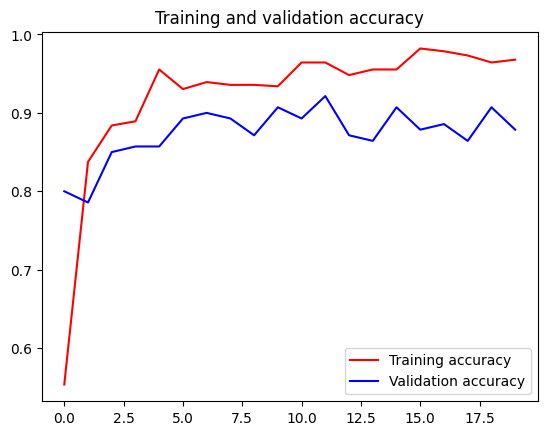

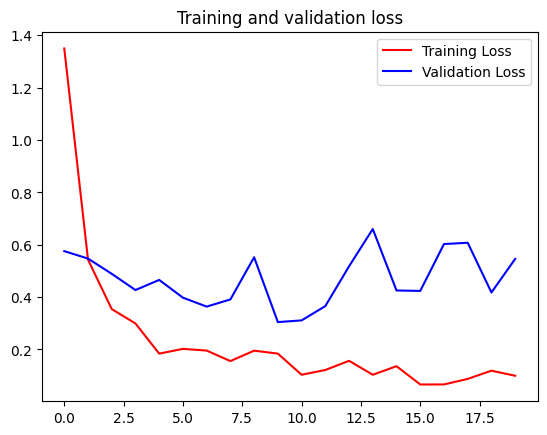

In [ ]:
# Plot the chart for accuracy and loss on both training and validation
acc = history_2.history['accuracy']
val_acc = history_2.history['val_accuracy']
loss = history_2.history['loss']
val_loss = history_2.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# Implement Transfer Learning 2 - InceptionV3 (partially trainable)

In [ ]:
for i, layer in enumerate(model_2.layers):
    print(i, layer.name)

0 input_5
1 conv2d_384
2 batch_normalization_376
3 activation_376
4 conv2d_385
5 batch_normalization_377
6 activation_377
7 conv2d_386
8 batch_normalization_378
9 activation_378
10 max_pooling2d_24
11 conv2d_387
12 batch_normalization_379
13 activation_379
14 conv2d_388
15 batch_normalization_380
16 activation_380
17 max_pooling2d_25
18 conv2d_392
19 batch_normalization_384
20 activation_384
21 conv2d_390
22 conv2d_393
23 batch_normalization_382
24 batch_normalization_385
25 activation_382
26 activation_385
27 average_pooling2d_36
28 conv2d_389
29 conv2d_391
30 conv2d_394
31 conv2d_395
32 batch_normalization_381
33 batch_normalization_383
34 batch_normalization_386
35 batch_normalization_387
36 activation_381
37 activation_383
38 activation_386
39 activation_387
40 mixed0
41 conv2d_399
42 batch_normalization_391
43 activation_391
44 conv2d_397
45 conv2d_400
46 batch_normalization_389
47 batch_normalization_392
48 activation_389
49 activation_392
50 average_pooling2d_37
51 conv2d_396
52

## Define partially trainable pre-trained model

In [ ]:
local_weights_file = '/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5'
def create_pre_trained_model(local_weights_file):
  """
  Initializes an InceptionV3 model.

  Args:
    local_weights_file (string): path pointing to a pretrained weights H5 file

  Returns:
    pre_trained_model: the initialized InceptionV3 model
  """

  pre_trained_model = InceptionV3(input_shape = (224, 224, 3),
                                  include_top = False,
                                  weights = None)

  pre_trained_model.load_weights(local_weights_file)

  # Make first 200 layers non-trainable and the rest of layer trainable in the pre-trained model
  for layer in pre_trained_model.layers[:200]:
    layer.trainable = False
  for layer in pre_trained_model.layers[200:]:
    layer.trainable = True

  return pre_trained_model

In [ ]:
pre_trained_model = create_pre_trained_model(local_weights_file)

# Print the model summary
pre_trained_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_478 (Conv2D)            (None, 111, 111, 32  864         ['input_6[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_470 (Batch  (None, 111, 111, 32  96         ['conv2d_478[0][0]']             
 Normalization)                 )                                                      

## Get output of certain layer

In [ ]:
def output_of_layer(pre_trained_model, layer_name):
  """
  Gets the output of certain layer in pre-trained model

  Args:
    pre_trained_model (tf.keras Model): model to get the last layer output from

  Returns:
    last_output: output of the model's last layer
  """
  last_desired_layer = pre_trained_model.get_layer(layer_name)
  print('last layer output shape: ', last_desired_layer.output_shape)
  last_output = last_desired_layer.output
  print('last layer output: ', last_output)

  return last_output

In [ ]:
last_output = output_of_layer(pre_trained_model, layer_name='mixed7')

last layer output shape:  (None, 12, 12, 768)
last layer output:  KerasTensor(type_spec=TensorSpec(shape=(None, 12, 12, 768), dtype=tf.float32, name=None), name='mixed7/concat:0', description="created by layer 'mixed7'")


## Define model

In [ ]:
def create_final_model(pre_trained_model, last_output):
  """
  Appends a custom model to a pre-trained model

  Args:
    pre_trained_model (tf.keras Model): model that will accept the train/test inputs
    last_output (tensor): last layer output of the pre-trained model

  Returns:
    model: the combined model
  """
  # Flatten the output layer to 1 dimension
  x = tf.keras.layers.Flatten()(last_output)
  x = tf.keras.layers.Dropout(0.5)(x)
  x = tf.keras.layers.Dense(64, activation='relu')(x)
  x = tf.keras.layers.Dense(32, activation='relu')(x)
  x = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

  # Create the complete model by using the Model class
  model = tf.keras.Model(inputs=pre_trained_model.input, outputs=x)

  # Compile the model
  model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001),
                loss = "categorical_crossentropy",
                metrics = ['accuracy'])

  model.summary()

  return model

In [ ]:
model_3 = create_final_model(pre_trained_model, last_output)

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_478 (Conv2D)            (None, 111, 111, 32  864         ['input_6[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_470 (Batch  (None, 111, 111, 32  96         ['conv2d_478[0][0]']             
 Normalization)                 )                                                           

## Define callback -  early stopper

In [ ]:
class MyThresholdCallback(tf.keras.callbacks.Callback):
  def __init__(self, threshold):
    super(MyThresholdCallback, self).__init__()
    self.threshold = threshold

  def on_epoch_end(self, epoch, logs=None):
    val_accuracy = logs["val_accuracy"]
    train_accuracy = logs["accuracy"]
    if val_accuracy > self.threshold and train_accuracy > self.threshold:
      self.model.stop_training = True

callbacks = MyThresholdCallback(threshold=0.9)

## Traning

In [ ]:
history_3 = model_3.fit(train_generator,
                           callbacks = [callbacks],
                           epochs=50,
                           validation_data = val_generator,
                           verbose = 1)

Epoch 1/50
56/56 [==============================] - 44s 183ms/step - loss: 1.7009 - accuracy: 0.3214 - val_loss: 1.2024 - val_accuracy: 0.5357
Epoch 2/50
56/56 [==============================] - 10s 174ms/step - loss: 0.8344 - accuracy: 0.7357 - val_loss: 0.4516 - val_accuracy: 0.8643
Epoch 3/50
56/56 [==============================] - 10s 186ms/step - loss: 0.4618 - accuracy: 0.8250 - val_loss: 0.4607 - val_accuracy: 0.8929
Epoch 4/50
56/56 [==============================] - 11s 188ms/step - loss: 0.2761 - accuracy: 0.9161 - val_loss: 0.3678 - val_accuracy: 0.9000
Epoch 5/50
56/56 [==============================] - 10s 174ms/step - loss: 0.3181 - accuracy: 0.9000 - val_loss: 0.5354 - val_accuracy: 0.8643
Epoch 6/50
56/56 [==============================] - 10s 172ms/step - loss: 0.2363 - accuracy: 0.9232 - val_loss: 0.3842 - val_accuracy: 0.9214


## Plotting

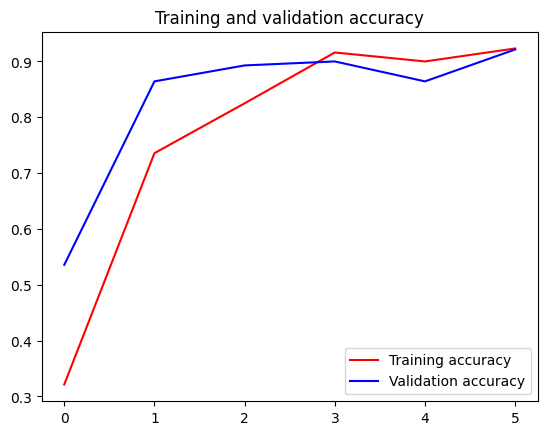

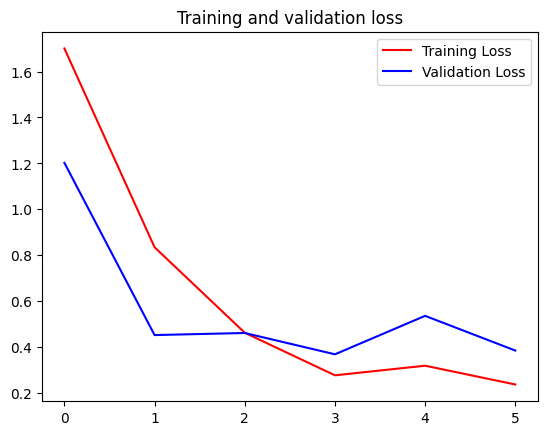

In [ ]:
# Plot the chart for accuracy and loss on both training and validation
acc = history_3.history['accuracy']
val_acc = history_3.history['val_accuracy']
loss = history_3.history['loss']
val_loss = history_3.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# Implement Transfer Learning 3 - MobileNetV2

In [ ]:
from tensorflow.keras.applications import MobileNetV2

## Define pre-trained model

In [ ]:
def create_pre_trained_model():
  """
  Initializes a MobileNetV2 model.

  Args:
    -

  Returns:
    pre_trained_model: the initialized MobileNetV2 model
  """

  base_model = MobileNetV2(
      include_top=False,
      weights='imagenet',
      input_shape=(224, 224, 3),
      alpha=0.5,
      pooling='avg'
  )

  # Make first 143 layers non-trainable and the rest of layer trainable in the pre-trained model
  for layer in base_model.layers[:143]:
    layer.trainable=False
  for layer in base_model.layers[143:]:
    layer.trainable=True

  return base_model

In [ ]:
pre_trained_model = create_pre_trained_model()

# Print the model summary
pre_trained_model.summary()

Model: "mobilenetv2_0.50_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 16  432         ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 16  64          ['Conv1[0][0]']                  
                                )                                              

In [ ]:
for i, layer in enumerate(pre_trained_model.layers):
    print(i, layer.name)

0 input_3
1 Conv1
2 bn_Conv1
3 Conv1_relu
4 expanded_conv_depthwise
5 expanded_conv_depthwise_BN
6 expanded_conv_depthwise_relu
7 expanded_conv_project
8 expanded_conv_project_BN
9 block_1_expand
10 block_1_expand_BN
11 block_1_expand_relu
12 block_1_pad
13 block_1_depthwise
14 block_1_depthwise_BN
15 block_1_depthwise_relu
16 block_1_project
17 block_1_project_BN
18 block_2_expand
19 block_2_expand_BN
20 block_2_expand_relu
21 block_2_depthwise
22 block_2_depthwise_BN
23 block_2_depthwise_relu
24 block_2_project
25 block_2_project_BN
26 block_2_add
27 block_3_expand
28 block_3_expand_BN
29 block_3_expand_relu
30 block_3_pad
31 block_3_depthwise
32 block_3_depthwise_BN
33 block_3_depthwise_relu
34 block_3_project
35 block_3_project_BN
36 block_4_expand
37 block_4_expand_BN
38 block_4_expand_relu
39 block_4_depthwise
40 block_4_depthwise_BN
41 block_4_depthwise_relu
42 block_4_project
43 block_4_project_BN
44 block_4_add
45 block_5_expand
46 block_5_expand_BN
47 block_5_expand_relu
48 b

## Get output of certain layer

In [ ]:
def output_of_layer(base_model, layer_name):
  """
  Gets the last layer output of a model

  Args:
    base_model (tf.keras Model): model to get the last layer output from

  Returns:
    last_output: output of the model's last layer
  """
  last_desired_layer = base_model.get_layer(layer_name)
  print('last layer output shape: ', last_desired_layer.output_shape)
  last_output = last_desired_layer.output
  print('last layer output: ', last_output)

  return last_output

In [ ]:
# # Uncomment to get certain output instead of last output
# # get certain output
# last_output = output_of_layer(pre_trained_model, layer_name='block_10_project_BN')

In [ ]:
# get last output
last_output = pre_trained_model.output

## Define model

In [ ]:
x = tf.keras.layers.Flatten()(last_output)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.L2(0.03))(x)
x = tf.keras.layers.Dense(64, activation='relu')(x)
x = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

# Create the complete model by using the Model class
model_4 = tf.keras.Model(inputs=pre_trained_model.input, outputs=x)
model_4.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 16  432         ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 16  64          ['Conv1[0][0]']                  
                                )                                                           

## Define callback - early stopper

In [ ]:
class MyEarlyStopperCallback(tf.keras.callbacks.Callback):
  def __init__(self, val_threshold=1, train_threshold=1):
    super(MyEarlyStopperCallback, self).__init__()
    self.val_threshold = val_threshold
    self.train_threshold = train_threshold

  def on_epoch_end(self, epoch, logs=None):
    val_accuracy = logs["val_accuracy"]
    train_accuracy = logs["accuracy"]
    if val_accuracy >= self.val_threshold or train_accuracy >= self.train_threshold:
      self.model.stop_training = True

early_stopper_callback = MyEarlyStopperCallback(val_threshold=0.9)

## Training

In [ ]:
model_4.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics=['accuracy'])
history_4 = model_4.fit(train_generator,
                        epochs=40,
                        validation_data = val_generator,
                        verbose = 1,
                        callbacks=[early_stopper_callback])

Epoch 1/40
56/56 [==============================] - 19s 201ms/step - loss: 1.1289 - accuracy: 0.7982 - val_loss: 1.2948 - val_accuracy: 0.8286
Epoch 2/40
30/56 [===============>..............] - ETA: 4s - loss: 1.0379 - accuracy: 0.8267

KeyboardInterrupt: ignored

## Plotting

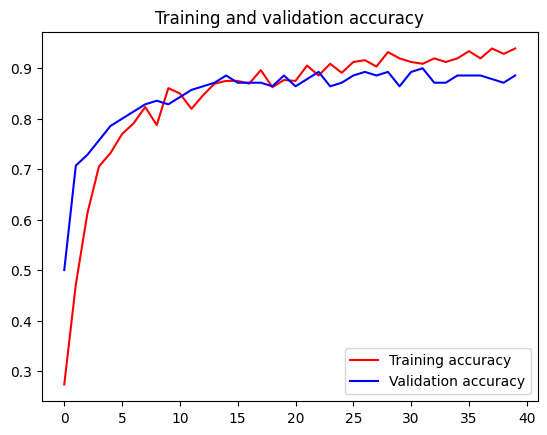

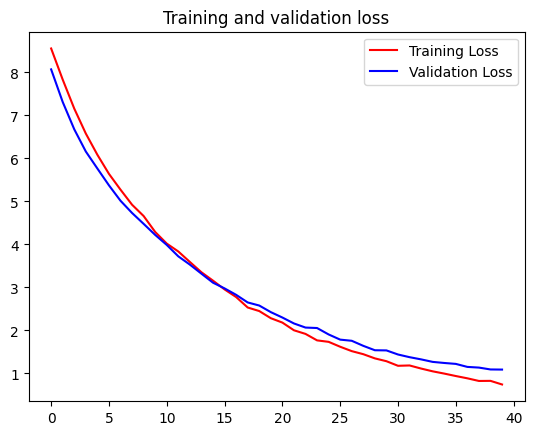

In [ ]:
# Plot the chart for accuracy and loss on both training and validation
acc = history_4.history['accuracy']
val_acc = history_4.history['val_accuracy']
loss = history_4.history['loss']
val_loss = history_4.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# Implement Transfer Learning 4 - MobileNet

In [ ]:
from tensorflow.keras.applications import MobileNet

## Define pre-trained model

In [ ]:
def create_pre_trained_model():
  """
  Initializes a MobileNet model.

  Args:
    -

  Returns:
    pre_trained_model: the initialized MobileNet model
  """

  base_model = MobileNet(
      include_top=False,
      weights='imagenet',
      input_shape=(224, 224, 3),
      pooling='avg'
  )

  # Make first 72 layers non-trainable and the rest of layer trainable in the pre-trained model
  for layer in base_model.layers[:72]:
    layer.trainable=False
  for layer in base_model.layers[72:]:
    layer.trainable=True

  return base_model

In [ ]:
pre_trained_model = create_pre_trained_model()

# Print the model summary
pre_trained_model.summary()

Model: "mobilenet_1.00_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_22 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                         

In [ ]:
for i, layer in enumerate(pre_trained_model.layers):
    print(i, layer.name)

0 input_22
1 conv1
2 conv1_bn
3 conv1_relu
4 conv_dw_1
5 conv_dw_1_bn
6 conv_dw_1_relu
7 conv_pw_1
8 conv_pw_1_bn
9 conv_pw_1_relu
10 conv_pad_2
11 conv_dw_2
12 conv_dw_2_bn
13 conv_dw_2_relu
14 conv_pw_2
15 conv_pw_2_bn
16 conv_pw_2_relu
17 conv_dw_3
18 conv_dw_3_bn
19 conv_dw_3_relu
20 conv_pw_3
21 conv_pw_3_bn
22 conv_pw_3_relu
23 conv_pad_4
24 conv_dw_4
25 conv_dw_4_bn
26 conv_dw_4_relu
27 conv_pw_4
28 conv_pw_4_bn
29 conv_pw_4_relu
30 conv_dw_5
31 conv_dw_5_bn
32 conv_dw_5_relu
33 conv_pw_5
34 conv_pw_5_bn
35 conv_pw_5_relu
36 conv_pad_6
37 conv_dw_6
38 conv_dw_6_bn
39 conv_dw_6_relu
40 conv_pw_6
41 conv_pw_6_bn
42 conv_pw_6_relu
43 conv_dw_7
44 conv_dw_7_bn
45 conv_dw_7_relu
46 conv_pw_7
47 conv_pw_7_bn
48 conv_pw_7_relu
49 conv_dw_8
50 conv_dw_8_bn
51 conv_dw_8_relu
52 conv_pw_8
53 conv_pw_8_bn
54 conv_pw_8_relu
55 conv_dw_9
56 conv_dw_9_bn
57 conv_dw_9_relu
58 conv_pw_9
59 conv_pw_9_bn
60 conv_pw_9_relu
61 conv_dw_10
62 conv_dw_10_bn
63 conv_dw_10_relu
64 conv_pw_10
65 conv_pw_

## Get output of certain layer

In [ ]:
def output_of_layer(base_model, layer_name):
  """
  Gets the last layer output of a model

  Args:
    base_model (tf.keras Model): model to get the last layer output from

  Returns:
    last_output: output of the model's last layer
  """
  last_desired_layer = base_model.get_layer(layer_name)
  print('last layer output shape: ', last_desired_layer.output_shape)
  last_output = last_desired_layer.output
  print('last layer output: ', last_output)

  return last_output

In [ ]:
# # Uncomment to get certain output instead of last output
# # get certain output
# last_output = output_of_layer(pre_trained_model, layer_name='block_10_project_BN')

In [ ]:
# get last output
last_output = pre_trained_model.output

## Define model

In [ ]:
x = tf.keras.layers.Flatten()(last_output)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)
x = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

# Create the complete model by using the Model class
model_5 = tf.keras.Model(inputs=pre_trained_model.input, outputs=x)
model_5.summary()

Model: "model_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_22 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                                   

## Define callback - early stopper

In [ ]:
class MyEarlyStopperCallback(tf.keras.callbacks.Callback):
  def __init__(self, val_threshold=1, train_threshold=1):
    super(MyEarlyStopperCallback, self).__init__()
    self.val_threshold = val_threshold
    self.train_threshold = train_threshold

  def on_epoch_end(self, epoch, logs=None):
    val_accuracy = logs["val_accuracy"]
    train_accuracy = logs["accuracy"]
    if val_accuracy >= self.val_threshold or train_accuracy >= self.train_threshold:
      self.model.stop_training = True

early_stopper_callback = MyEarlyStopperCallback(val_threshold=0.95)

## Training

In [ ]:
model_5.compile(loss = 'categorical_crossentropy', optimizer = tf.optimizers.RMSprop(learning_rate=0.00001), metrics=['accuracy'])
history_5 = model_5.fit(train_generator,
                        epochs=100,
                        validation_data = val_generator,
                        verbose = 1,
                        callbacks=[early_stopper_callback])

Epoch 1/100
56/56 [==============================] - 14s 193ms/step - loss: 2.8283 - accuracy: 0.1464 - val_loss: 2.0362 - val_accuracy: 0.2000
Epoch 2/100
56/56 [==============================] - 10s 180ms/step - loss: 2.2735 - accuracy: 0.2107 - val_loss: 1.8267 - val_accuracy: 0.2714
Epoch 3/100
56/56 [==============================] - 8s 148ms/step - loss: 2.0239 - accuracy: 0.2554 - val_loss: 1.6577 - val_accuracy: 0.3286
Epoch 4/100
56/56 [==============================] - 10s 182ms/step - loss: 1.8586 - accuracy: 0.2821 - val_loss: 1.5020 - val_accuracy: 0.4714
Epoch 5/100
56/56 [==============================] - 10s 180ms/step - loss: 1.7194 - accuracy: 0.3339 - val_loss: 1.3787 - val_accuracy: 0.5571
Epoch 6/100
56/56 [==============================] - 8s 148ms/step - loss: 1.6282 - accuracy: 0.3661 - val_loss: 1.2793 - val_accuracy: 0.6500
Epoch 7/100
56/56 [==============================] - 10s 182ms/step - loss: 1.5306 - accuracy: 0.4429 - val_loss: 1.1912 - val_accuracy: 0

## Plotting

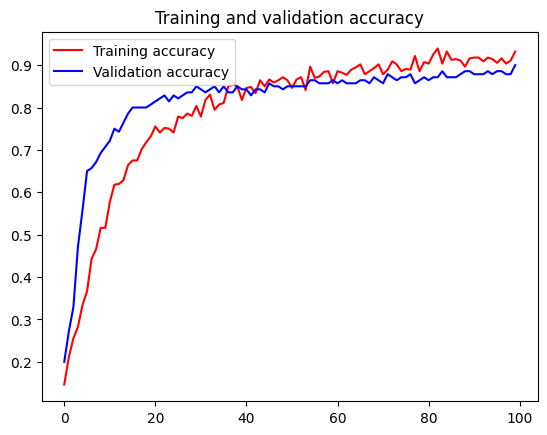

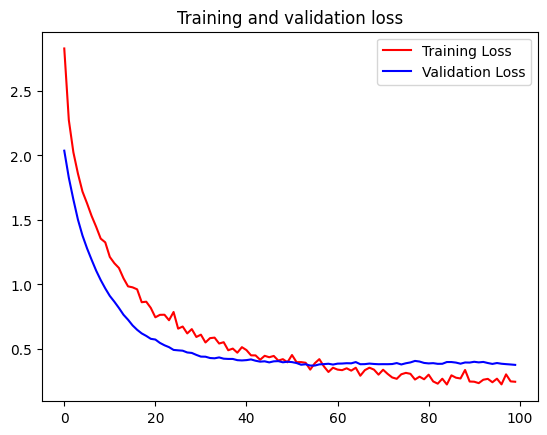

In [ ]:
# Plot the chart for accuracy and loss on both training and validation
acc = history_5.history['accuracy']
val_acc = history_5.history['val_accuracy']
loss = history_5.history['loss']
val_loss = history_5.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# Save and import to/from HDF5

## Save
Save path that we use =  "Saved model/batik_pattern_recorgnizer_&lt;train_accuracy&gt;\_&lt;val_accuracy&gt;\_&lt;model_name&gt;"

In [ ]:
save_path = "./Saved model/batik_pattern_recognizer_9321_9000_MobileNet/"

### Save model

In [ ]:
model_5.save(save_path + "model.h5")

### Save label

In [ ]:
with open(save_path + "label.txt", 'w') as f:
  CLASS_NAMES = list(train_generator.class_indices)
  for CLASS in CLASS_NAMES:
    f.write("%s\n" % CLASS)

## Import

In [ ]:
!ls 'Saved model'

batik_pattern_recognizer_8482_8143_MobileNetV2
batik_pattern_recognizer_8607_7643_MobileNetV2
batik_pattern_recognizer_9321_9000_MobileNet
batik_pattern_recognizer_9607_8929_InceptionV3
batik_pattern_recognizer_9708_8750_InceptionV3
batik_pattern_recognizer_9750_8500_MobileNetV2


In [ ]:
import_path = "Saved model/batik_pattern_recognizer_9321_9000_MobileNet/"

### Load model

In [ ]:
imported_model = tf.keras.models.load_model(import_path + "model.h5")
imported_model.summary()

Model: "model_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_22 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                                   

### Load label

In [ ]:
with open(import_path + "label.txt", "r") as f:
  lines = f.read()
  motives_list = lines.strip().split("\n")
  print(motives_list)

['Insang', 'Kawung', 'Mega mendung', 'Parang', 'Sidoluhur', 'Truntum', 'Tumpal']


# Testing

## Classes

In [ ]:
print(motives_list)

['Insang', 'Kawung', 'Mega mendung', 'Parang', 'Sidoluhur', 'Truntum', 'Tumpal']


## Show image

In [ ]:
def show_img(img_array):
  plt.figure(figsize=(4,4))
  plt.imshow(img_array)
  plt.show()

## Testing

In [ ]:
def test_model(model):
  """
    This test code block will predict all images in the TEST_DIR. TEST_DIR contains 20 images for each batik motives.
    Each predict will print out the prediction motive, confidence, and the tested image.
  """
  TEST_DIR = "/tmp/batikimages/test/"
  y_true = []
  y_pred = []
  output = ""
  print("Start testing model to predict 7 types of batik motives")
  print('-----------------------------------------------------------')
  for motive in motives_list:
      IMAGES = os.listdir(os.path.join(TEST_DIR, motive))

      correct_count = 0
      first = True
      print(f'-> Classifying Batik {motive}')
      for idx, TEST_IMAGE in enumerate(IMAGES):
          img_path = os.path.join(TEST_DIR, motive, TEST_IMAGE)
          img = load_img(img_path, target_size=(224, 224, 3))

          img_array = img_to_array(img) / 255.0
          img_array = tf.expand_dims(img_array, 0)

          prediction = model.predict(img_array, verbose = 0)
          pred_idx = np.argmax(prediction)
          pred_motive = motives_list[pred_idx]
          pred_confidence = prediction[0][pred_idx] * 100
          print(f"I see Batik {pred_motive} - confidence: {pred_confidence:.2f}% ({pred_motive == motive})")

          show_img(img_to_array(img) / 255.0)

          if pred_motive == motive:
              correct_count += 1

          y_true.append(motive)
          y_pred.append(pred_motive)

      output += f'Batik {motive} Predictions --> {correct_count}/20 correct\n'
      print('-----------------------------------------------------------')

  print("Finish testing model")
  print("Summary:")
  print(output)

  return y_true, y_pred


Start testing model to predict 7 types of batik motives
-----------------------------------------------------------
-> Classifying Batik Insang
I see Batik Mega mendung - confidence: 82.03% (False)


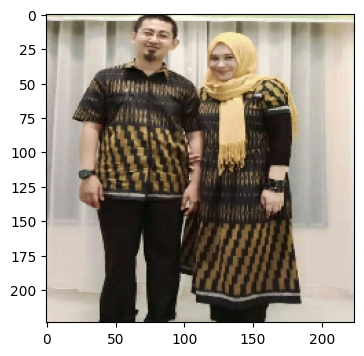

I see Batik Mega mendung - confidence: 94.07% (False)


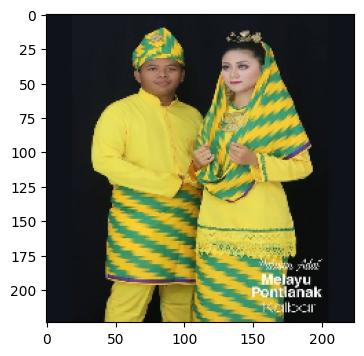

I see Batik Insang - confidence: 92.51% (True)


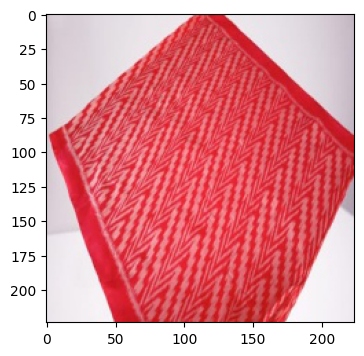

I see Batik Insang - confidence: 99.98% (True)


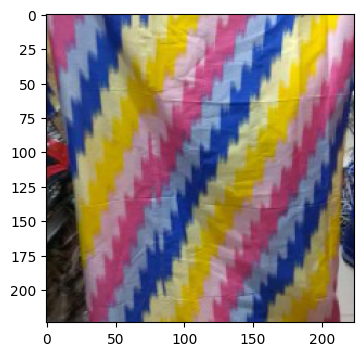

I see Batik Insang - confidence: 93.06% (True)


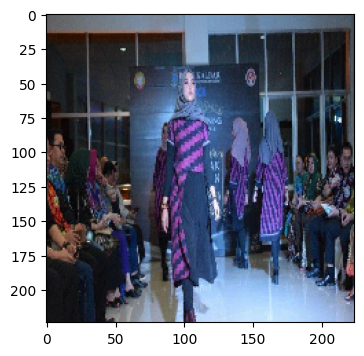

I see Batik Insang - confidence: 99.99% (True)


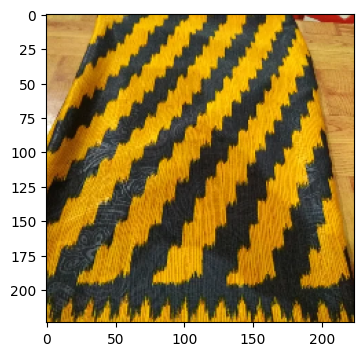

I see Batik Insang - confidence: 99.99% (True)


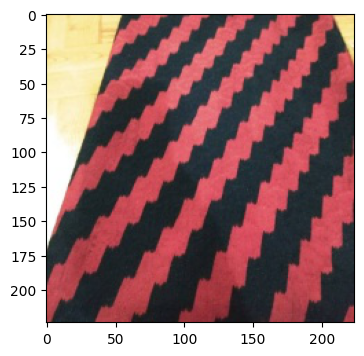

I see Batik Insang - confidence: 90.17% (True)


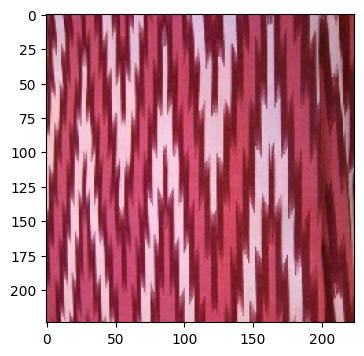

I see Batik Insang - confidence: 100.00% (True)


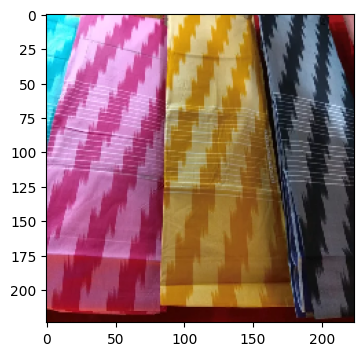

I see Batik Insang - confidence: 99.84% (True)


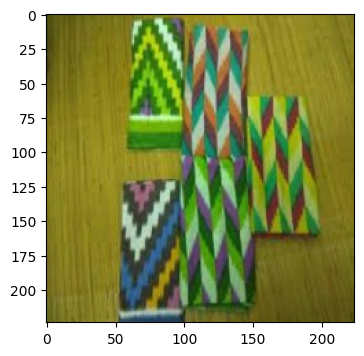

I see Batik Insang - confidence: 99.72% (True)


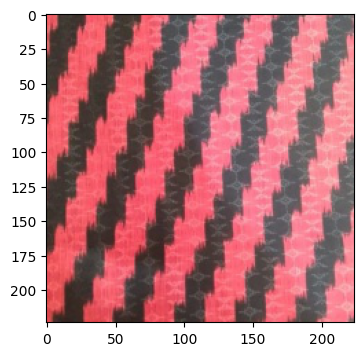

I see Batik Insang - confidence: 99.99% (True)


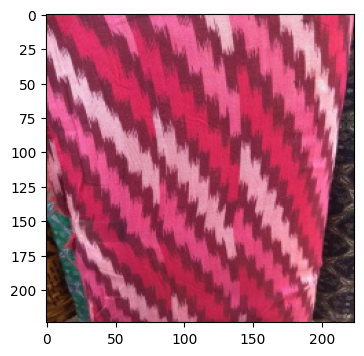

I see Batik Insang - confidence: 96.07% (True)


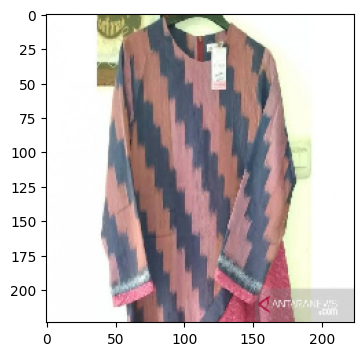

I see Batik Insang - confidence: 100.00% (True)


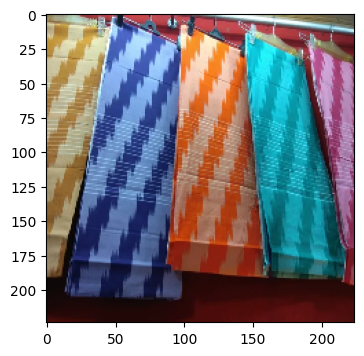

I see Batik Insang - confidence: 97.87% (True)


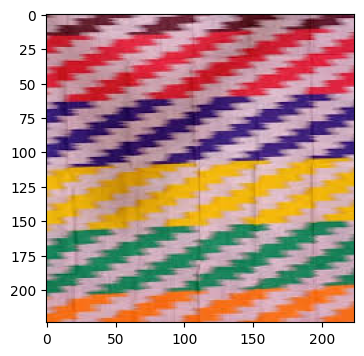

I see Batik Insang - confidence: 98.74% (True)


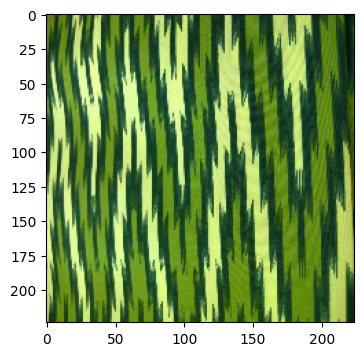

I see Batik Insang - confidence: 100.00% (True)


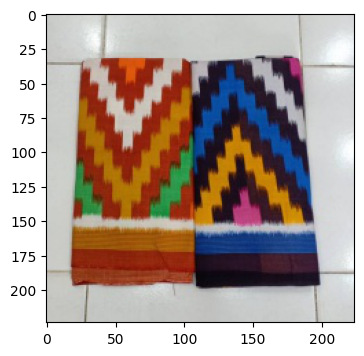

I see Batik Insang - confidence: 96.13% (True)


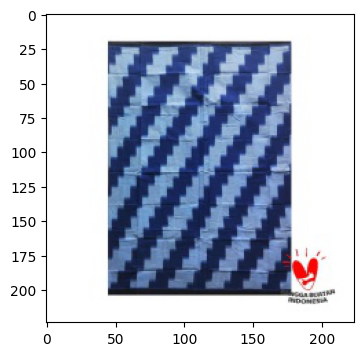

I see Batik Insang - confidence: 35.03% (True)


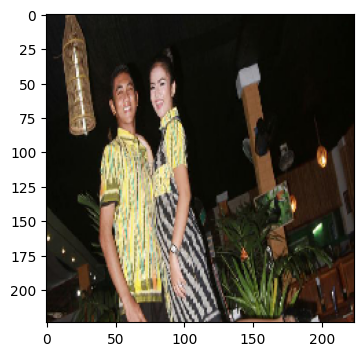

I see Batik Insang - confidence: 97.97% (True)


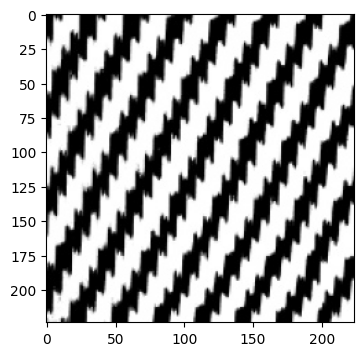

-----------------------------------------------------------
-> Classifying Batik Kawung
I see Batik Truntum - confidence: 58.17% (False)


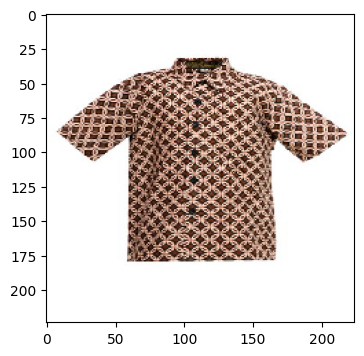

I see Batik Sidoluhur - confidence: 81.57% (False)


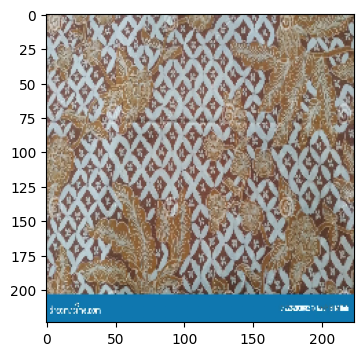

I see Batik Kawung - confidence: 82.14% (True)


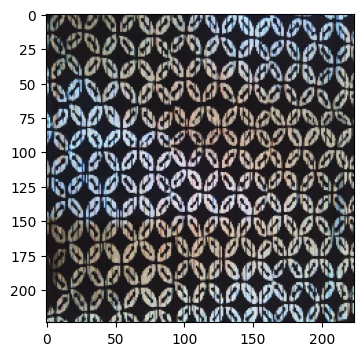

I see Batik Kawung - confidence: 46.16% (True)


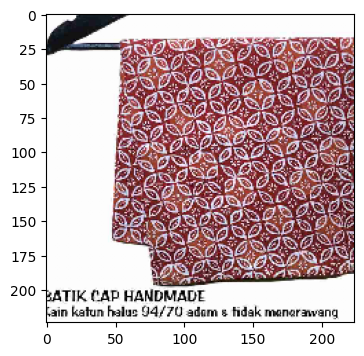

I see Batik Kawung - confidence: 82.08% (True)


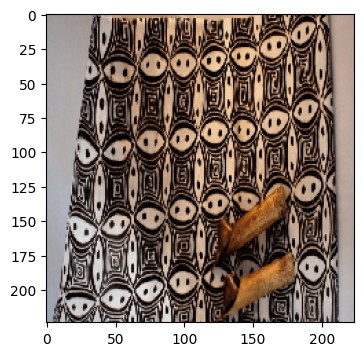

I see Batik Kawung - confidence: 99.29% (True)


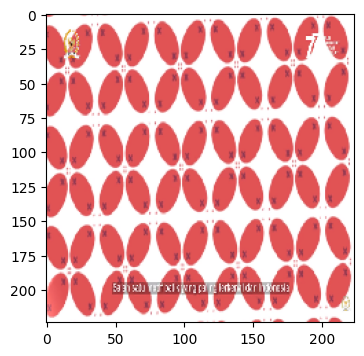

I see Batik Kawung - confidence: 99.96% (True)


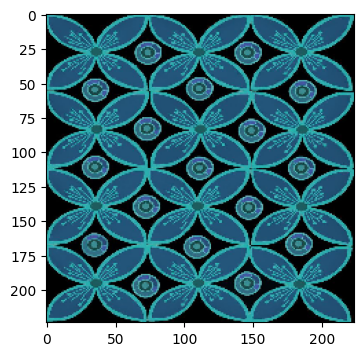

I see Batik Kawung - confidence: 83.84% (True)


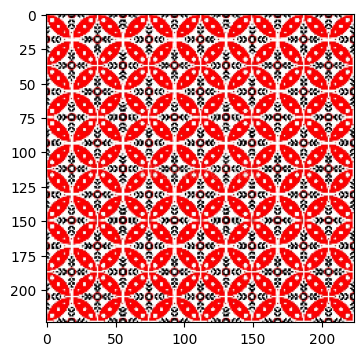

I see Batik Kawung - confidence: 85.74% (True)


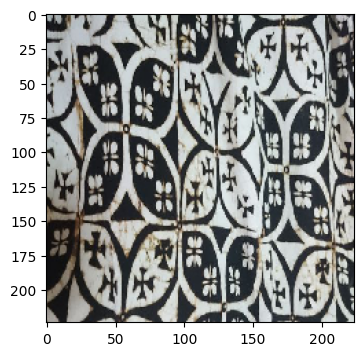

I see Batik Kawung - confidence: 98.33% (True)


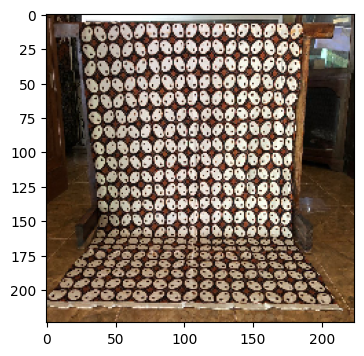

I see Batik Kawung - confidence: 97.49% (True)


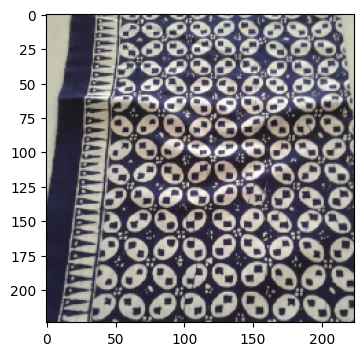

I see Batik Sidoluhur - confidence: 58.02% (False)


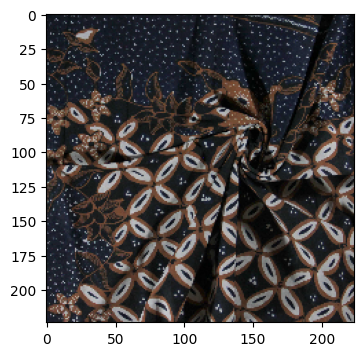

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


I see Batik Kawung - confidence: 99.25% (True)


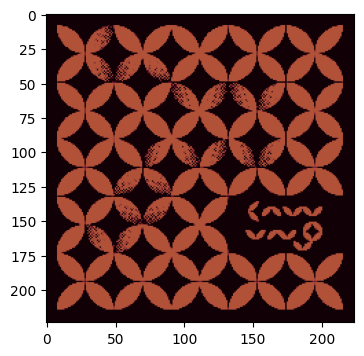

I see Batik Kawung - confidence: 98.80% (True)


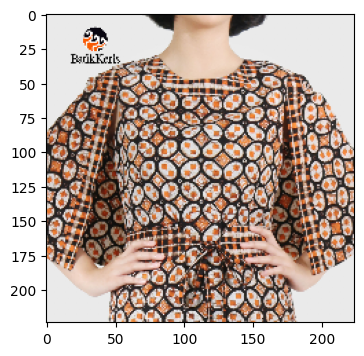

I see Batik Kawung - confidence: 99.95% (True)


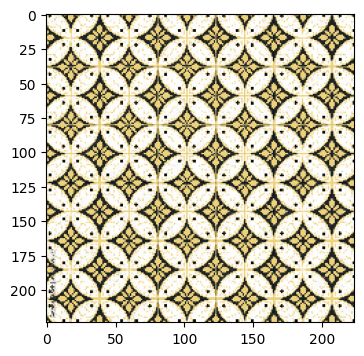

I see Batik Kawung - confidence: 99.87% (True)


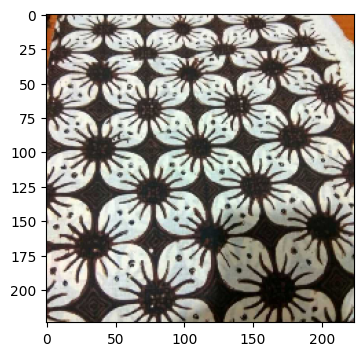

I see Batik Kawung - confidence: 100.00% (True)


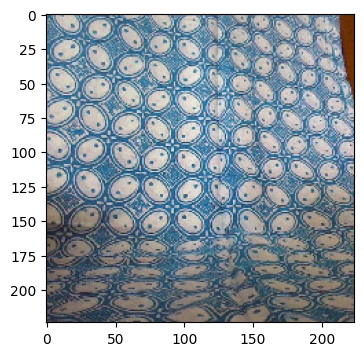

I see Batik Kawung - confidence: 99.94% (True)


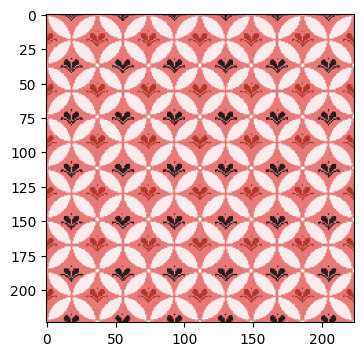

I see Batik Kawung - confidence: 64.77% (True)


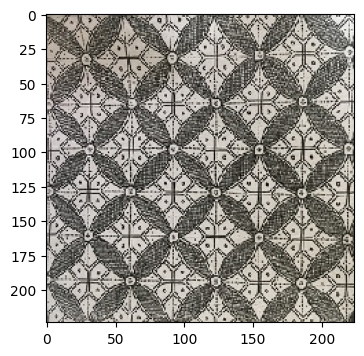

I see Batik Kawung - confidence: 75.93% (True)


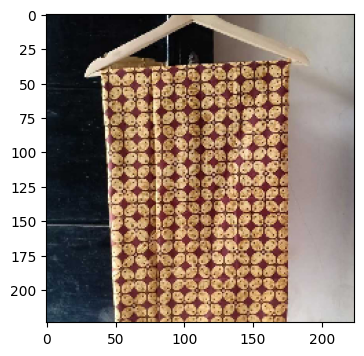

-----------------------------------------------------------
-> Classifying Batik Mega mendung
I see Batik Mega mendung - confidence: 97.00% (True)


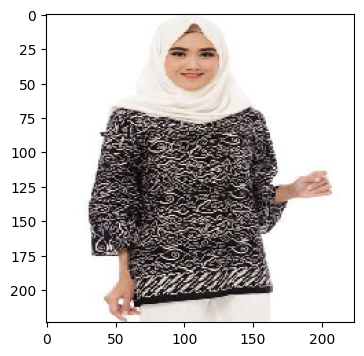

I see Batik Mega mendung - confidence: 99.91% (True)


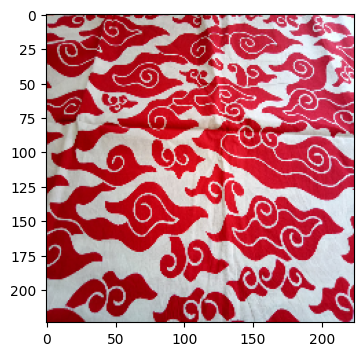

I see Batik Mega mendung - confidence: 70.32% (True)


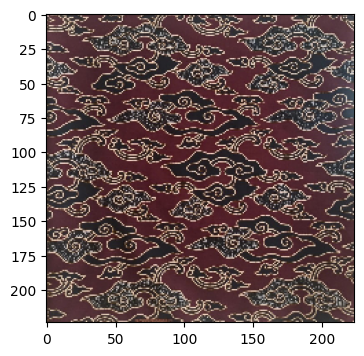

I see Batik Mega mendung - confidence: 99.83% (True)


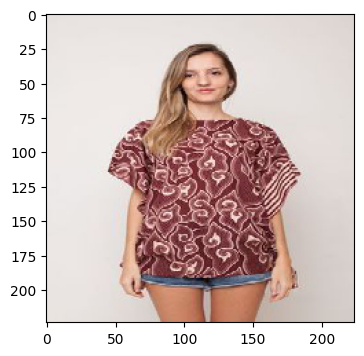

I see Batik Mega mendung - confidence: 100.00% (True)


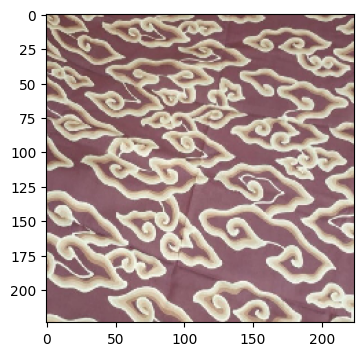

I see Batik Mega mendung - confidence: 99.98% (True)


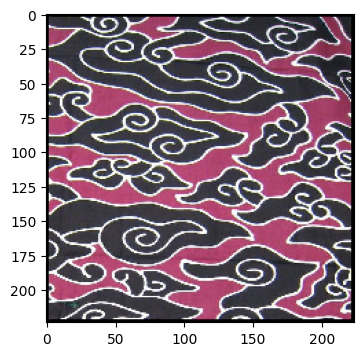

I see Batik Mega mendung - confidence: 99.28% (True)


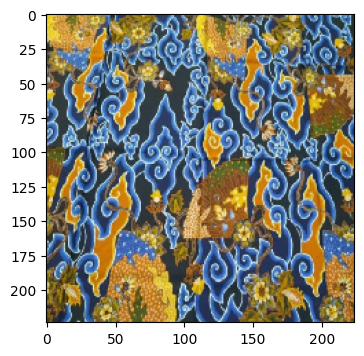

I see Batik Kawung - confidence: 75.76% (False)


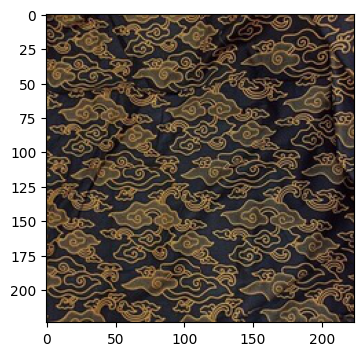

I see Batik Mega mendung - confidence: 100.00% (True)


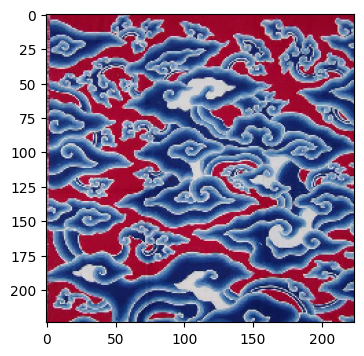

I see Batik Sidoluhur - confidence: 48.56% (False)


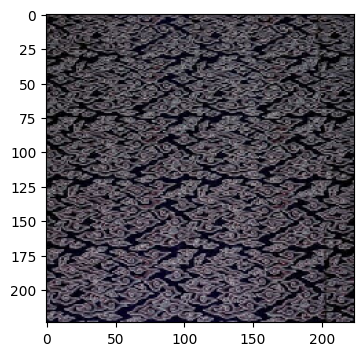

I see Batik Mega mendung - confidence: 100.00% (True)


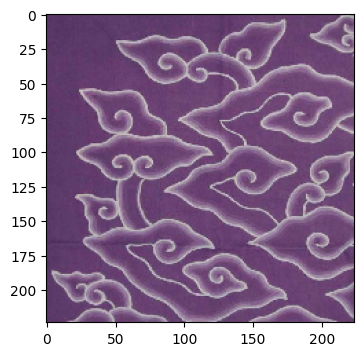

I see Batik Mega mendung - confidence: 100.00% (True)


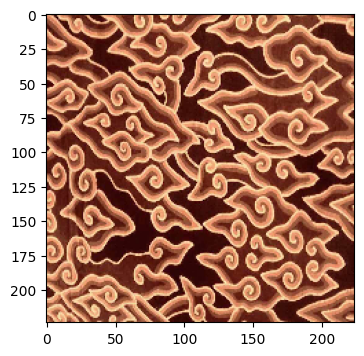

I see Batik Mega mendung - confidence: 99.99% (True)


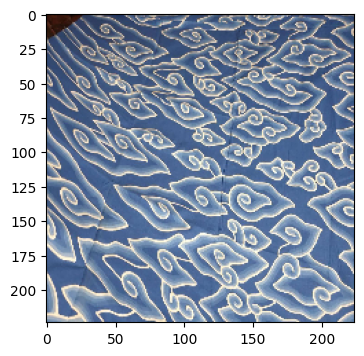

I see Batik Mega mendung - confidence: 100.00% (True)


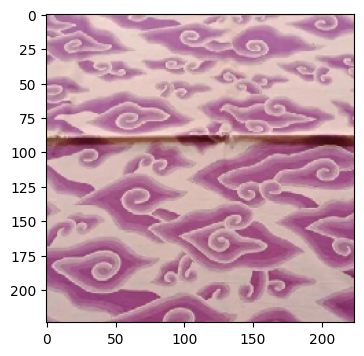

I see Batik Mega mendung - confidence: 99.99% (True)


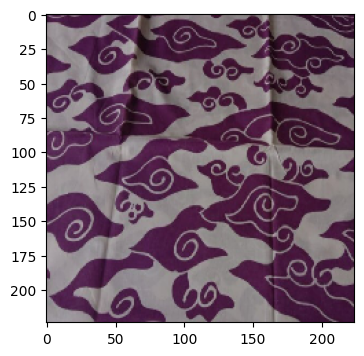

I see Batik Mega mendung - confidence: 99.93% (True)


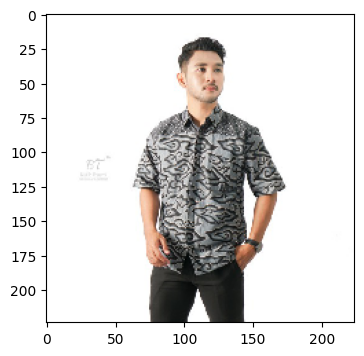

I see Batik Mega mendung - confidence: 99.92% (True)


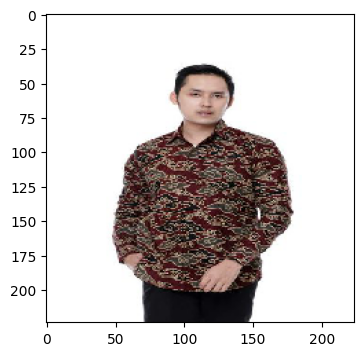

I see Batik Mega mendung - confidence: 99.89% (True)


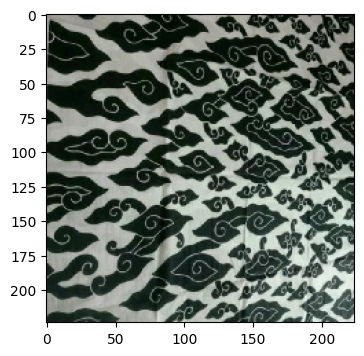

I see Batik Mega mendung - confidence: 99.99% (True)


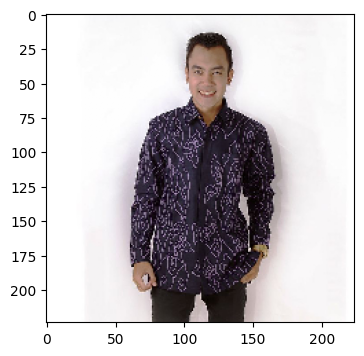

I see Batik Mega mendung - confidence: 99.93% (True)


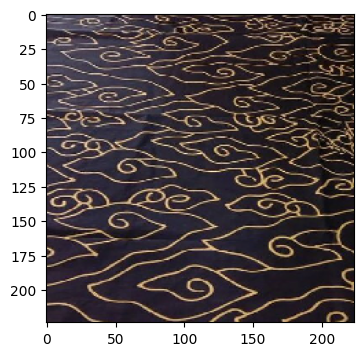

-----------------------------------------------------------
-> Classifying Batik Parang
I see Batik Parang - confidence: 99.88% (True)


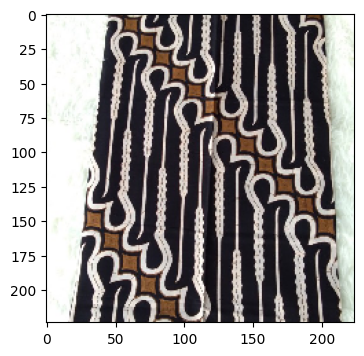

I see Batik Parang - confidence: 99.28% (True)


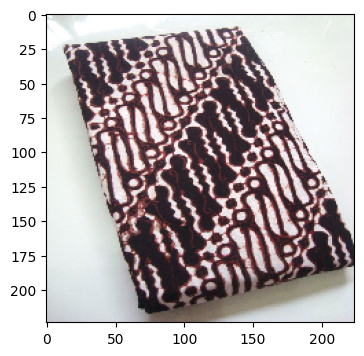

I see Batik Tumpal - confidence: 79.61% (False)


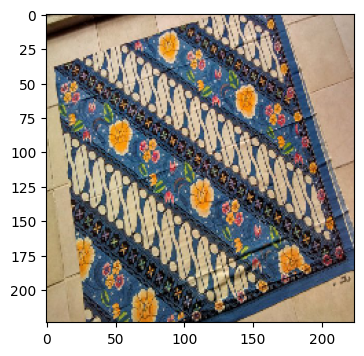

I see Batik Parang - confidence: 100.00% (True)


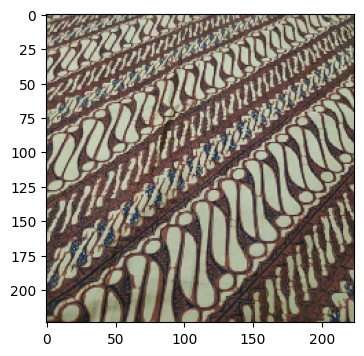

I see Batik Parang - confidence: 100.00% (True)


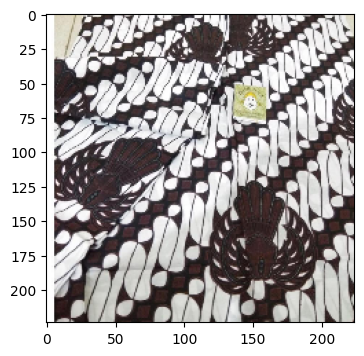

I see Batik Parang - confidence: 90.97% (True)


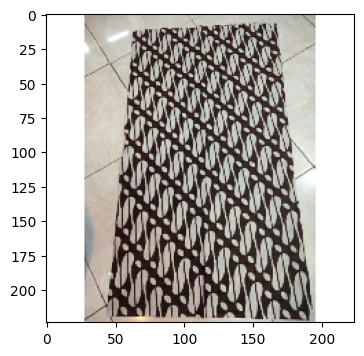

I see Batik Mega mendung - confidence: 49.94% (False)


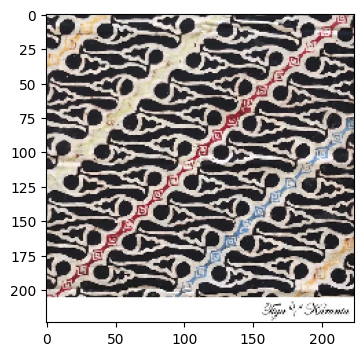

I see Batik Parang - confidence: 83.00% (True)


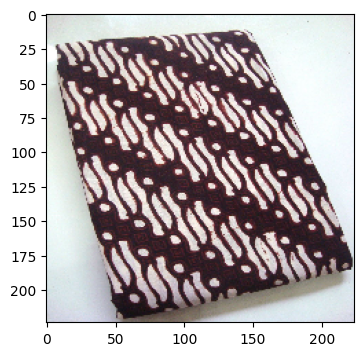

I see Batik Parang - confidence: 99.60% (True)


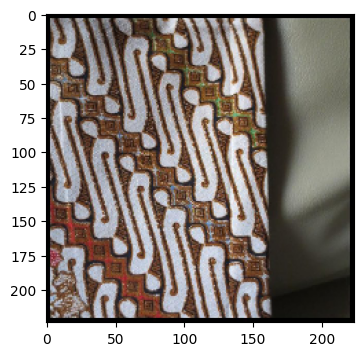

I see Batik Mega mendung - confidence: 99.67% (False)


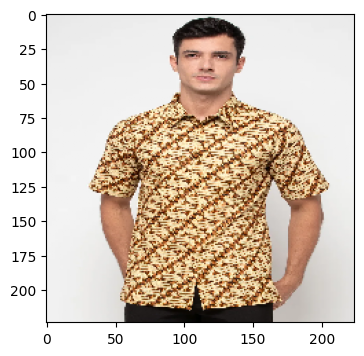

I see Batik Parang - confidence: 98.76% (True)


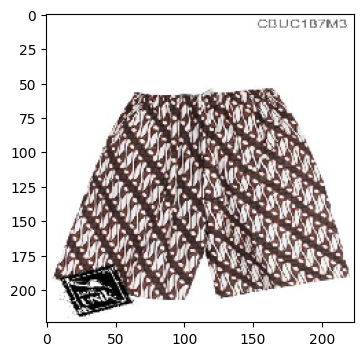

I see Batik Parang - confidence: 100.00% (True)


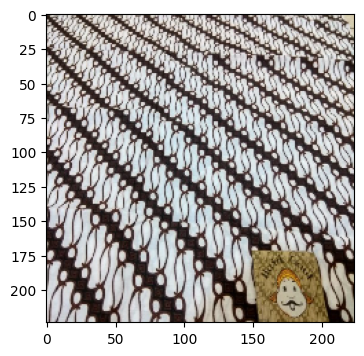

I see Batik Parang - confidence: 99.76% (True)


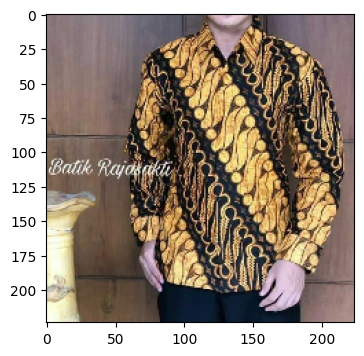

I see Batik Tumpal - confidence: 47.45% (False)


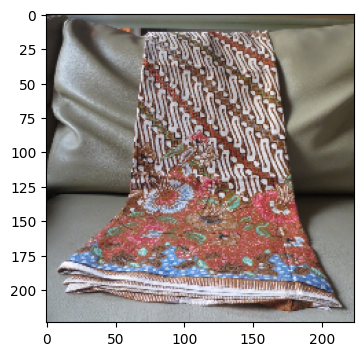

I see Batik Parang - confidence: 75.42% (True)


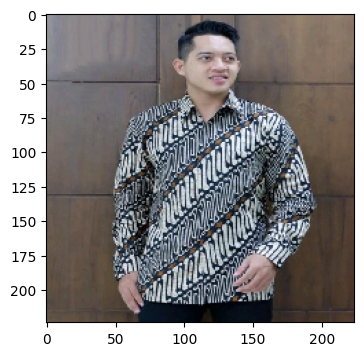

I see Batik Parang - confidence: 83.68% (True)


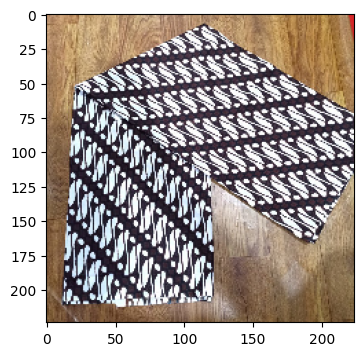

I see Batik Parang - confidence: 99.94% (True)


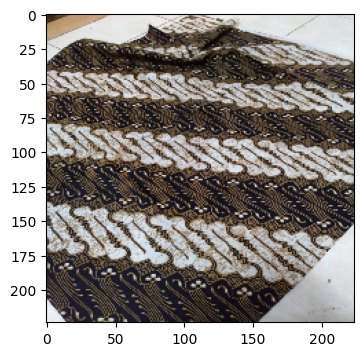

I see Batik Insang - confidence: 59.07% (False)


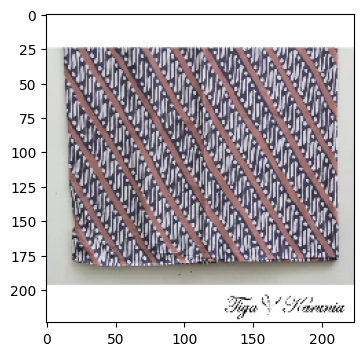

I see Batik Parang - confidence: 100.00% (True)


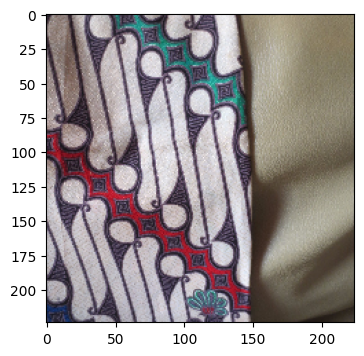

I see Batik Parang - confidence: 98.40% (True)


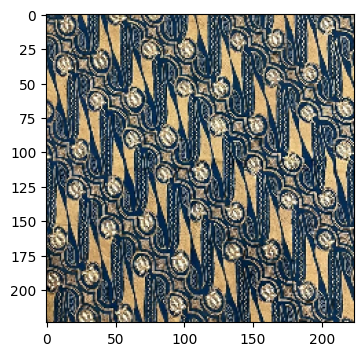

-----------------------------------------------------------
-> Classifying Batik Sidoluhur
I see Batik Sidoluhur - confidence: 99.88% (True)


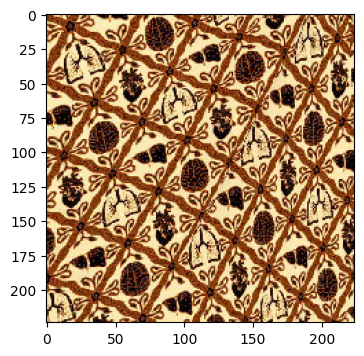

I see Batik Sidoluhur - confidence: 63.84% (True)


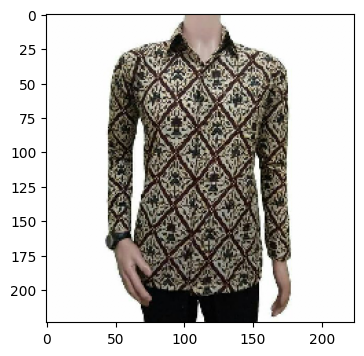

I see Batik Sidoluhur - confidence: 99.31% (True)


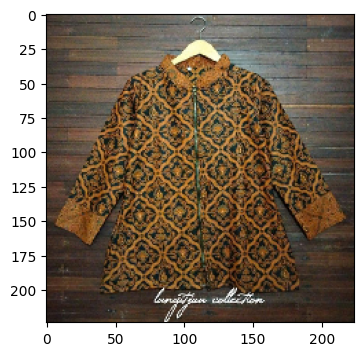

I see Batik Mega mendung - confidence: 50.49% (False)


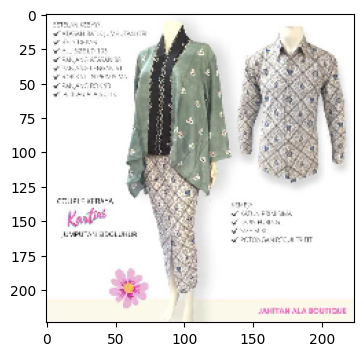

I see Batik Sidoluhur - confidence: 99.70% (True)


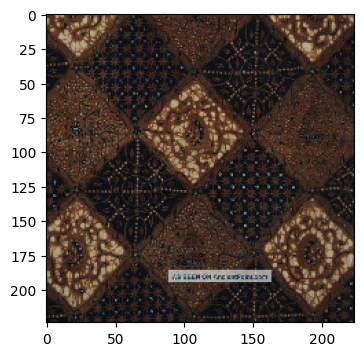

I see Batik Sidoluhur - confidence: 99.99% (True)


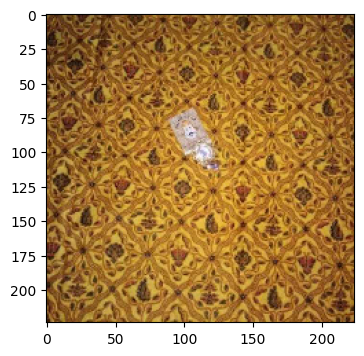

I see Batik Sidoluhur - confidence: 99.85% (True)


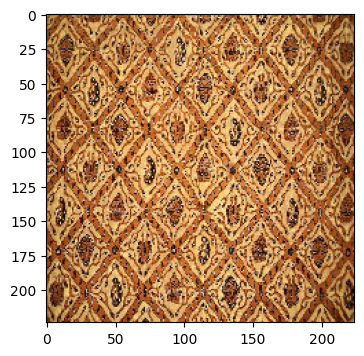

I see Batik Sidoluhur - confidence: 99.59% (True)


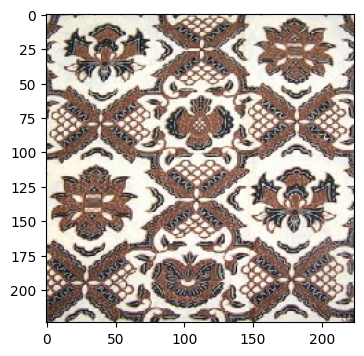

I see Batik Sidoluhur - confidence: 79.53% (True)


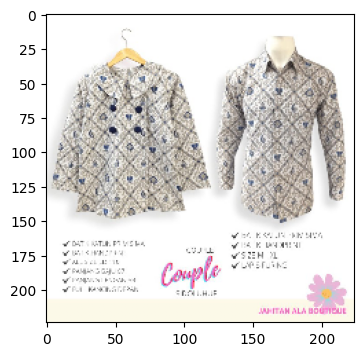

I see Batik Sidoluhur - confidence: 99.87% (True)


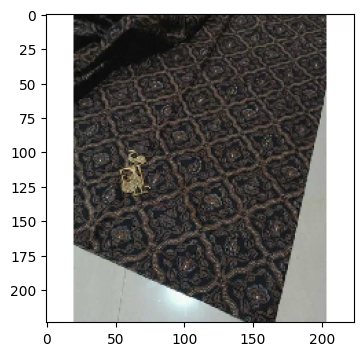

I see Batik Sidoluhur - confidence: 99.99% (True)


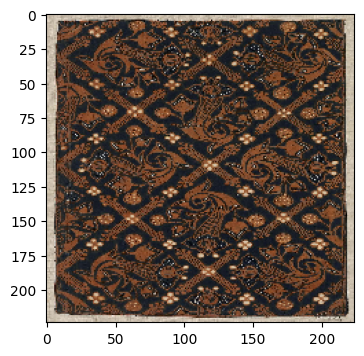

I see Batik Sidoluhur - confidence: 99.98% (True)


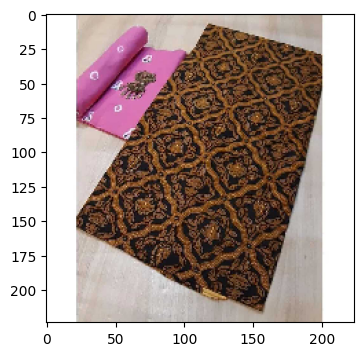

I see Batik Kawung - confidence: 96.27% (False)


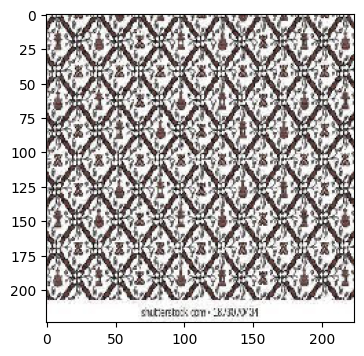

I see Batik Sidoluhur - confidence: 99.64% (True)


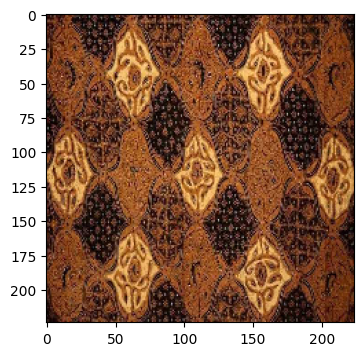

I see Batik Sidoluhur - confidence: 100.00% (True)


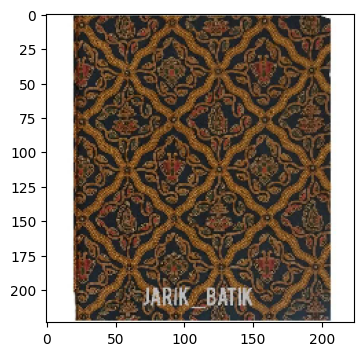

I see Batik Mega mendung - confidence: 63.52% (False)


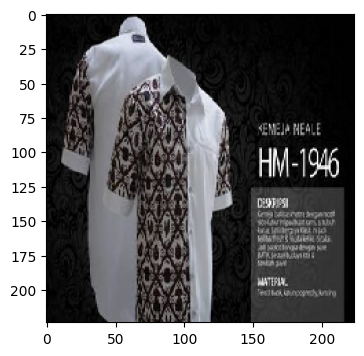

I see Batik Sidoluhur - confidence: 99.93% (True)


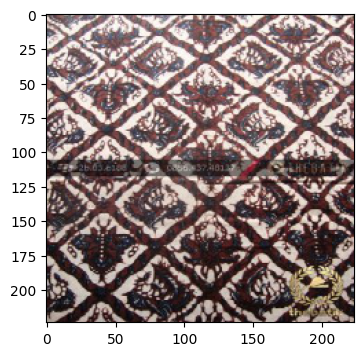

I see Batik Sidoluhur - confidence: 99.96% (True)


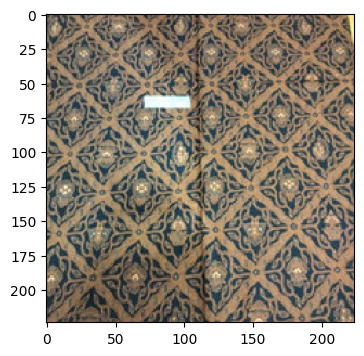

I see Batik Sidoluhur - confidence: 99.82% (True)


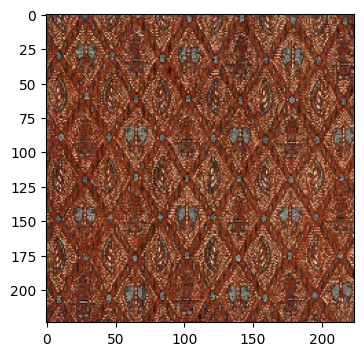

I see Batik Sidoluhur - confidence: 99.72% (True)


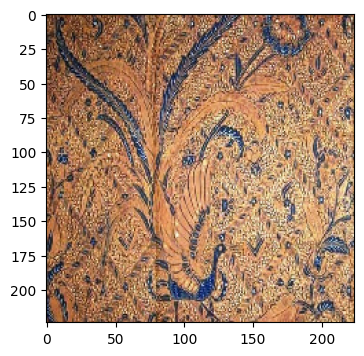

-----------------------------------------------------------
-> Classifying Batik Truntum
I see Batik Mega mendung - confidence: 54.26% (False)


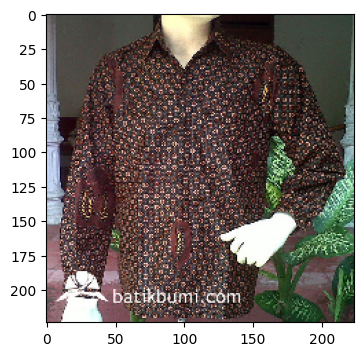

I see Batik Tumpal - confidence: 74.85% (False)


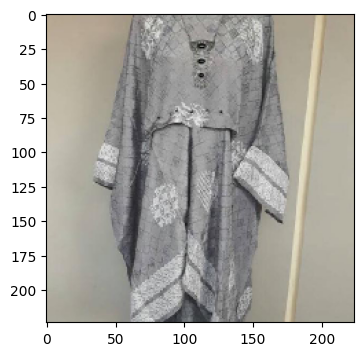

I see Batik Mega mendung - confidence: 79.76% (False)


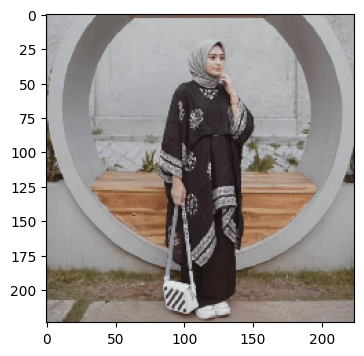

I see Batik Sidoluhur - confidence: 69.40% (False)


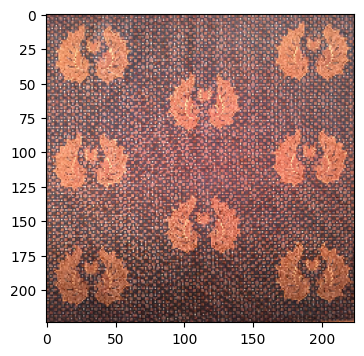

I see Batik Sidoluhur - confidence: 64.43% (False)


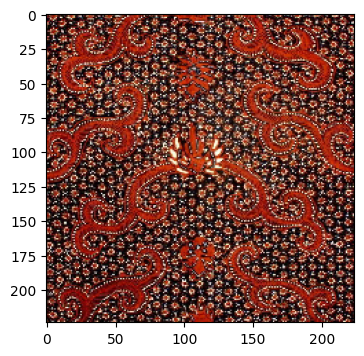

I see Batik Truntum - confidence: 81.69% (True)


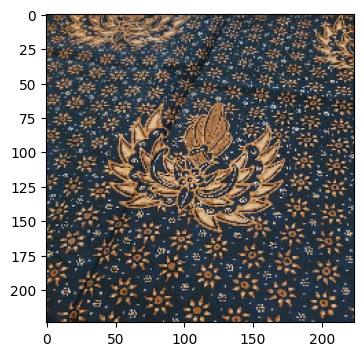

I see Batik Sidoluhur - confidence: 84.45% (False)


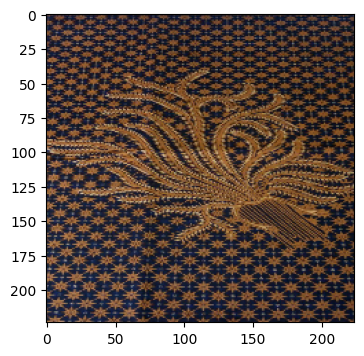

I see Batik Tumpal - confidence: 65.49% (False)


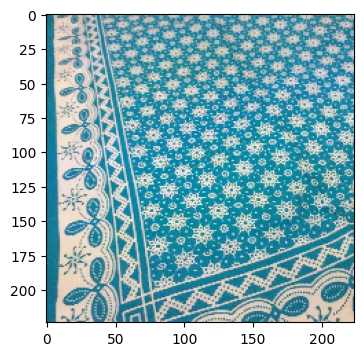

I see Batik Truntum - confidence: 91.94% (True)


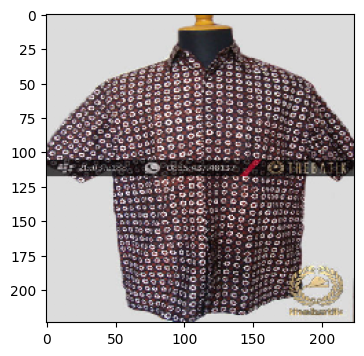

I see Batik Truntum - confidence: 67.61% (True)


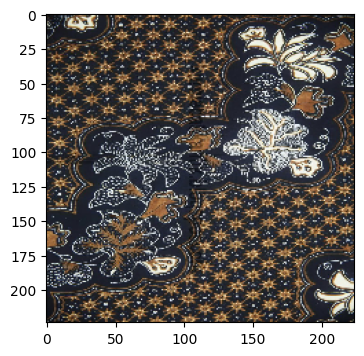

I see Batik Sidoluhur - confidence: 99.82% (False)


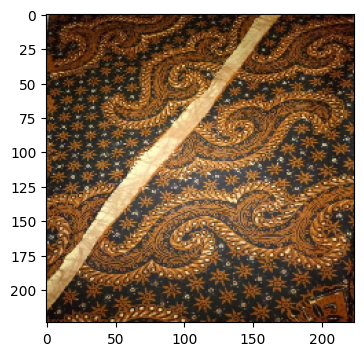

I see Batik Truntum - confidence: 99.84% (True)


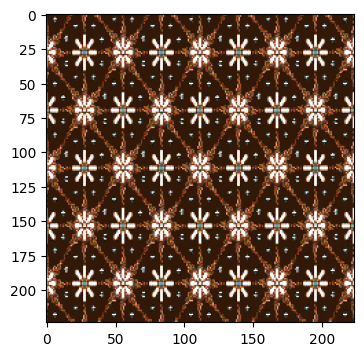

I see Batik Sidoluhur - confidence: 54.39% (False)


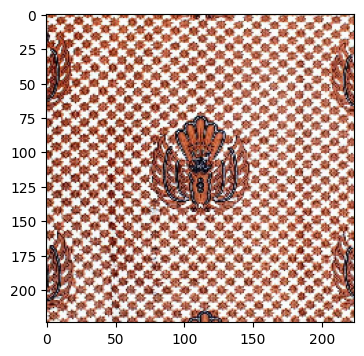

I see Batik Truntum - confidence: 97.18% (True)


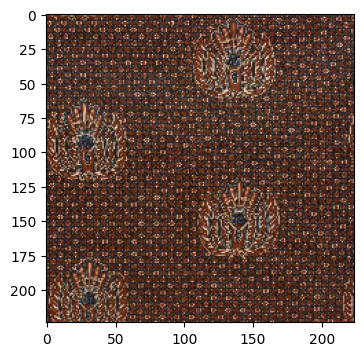

I see Batik Truntum - confidence: 99.06% (True)


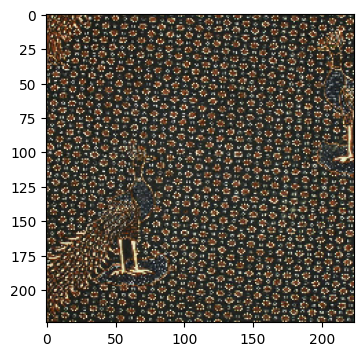

I see Batik Sidoluhur - confidence: 98.78% (False)


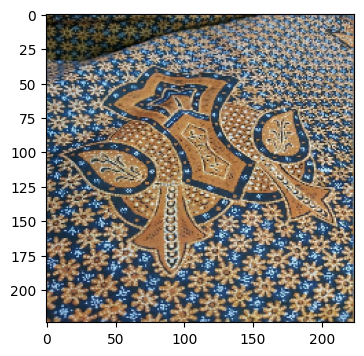

I see Batik Truntum - confidence: 52.20% (True)


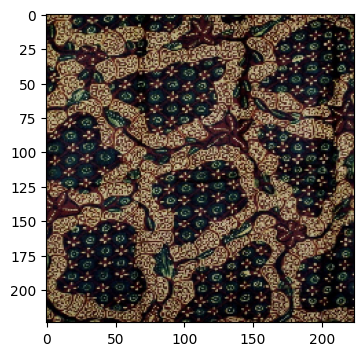

I see Batik Truntum - confidence: 97.18% (True)


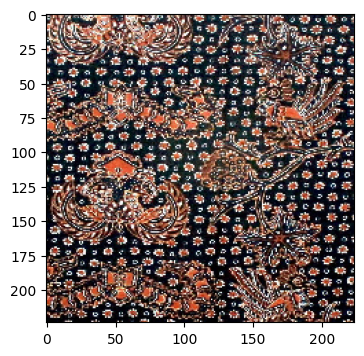

I see Batik Mega mendung - confidence: 43.84% (False)


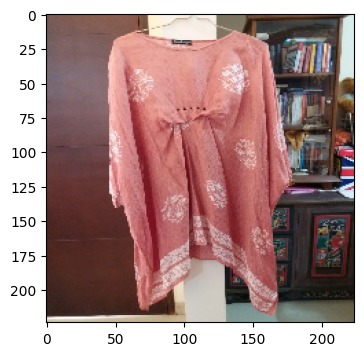

I see Batik Truntum - confidence: 59.03% (True)


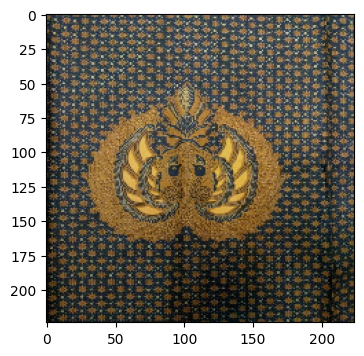

-----------------------------------------------------------
-> Classifying Batik Tumpal
I see Batik Tumpal - confidence: 100.00% (True)


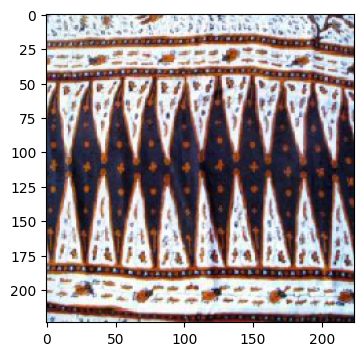

I see Batik Tumpal - confidence: 100.00% (True)


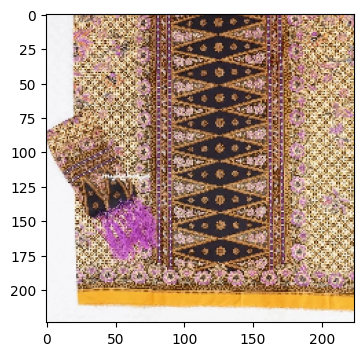

I see Batik Tumpal - confidence: 100.00% (True)


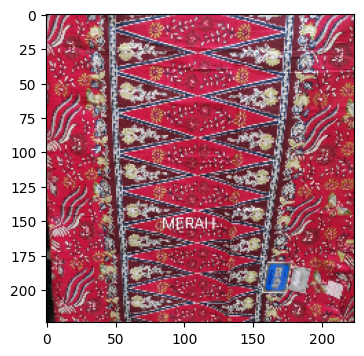

I see Batik Tumpal - confidence: 100.00% (True)


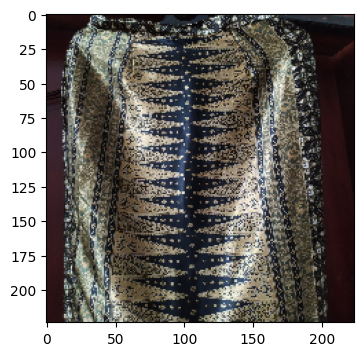

I see Batik Tumpal - confidence: 99.46% (True)


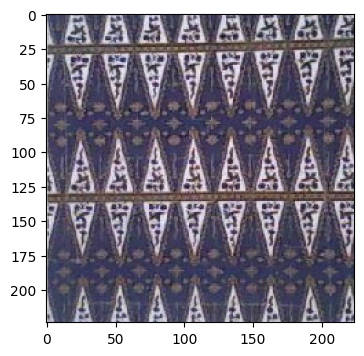

I see Batik Tumpal - confidence: 99.97% (True)


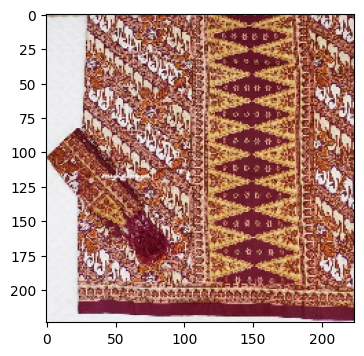

I see Batik Tumpal - confidence: 100.00% (True)


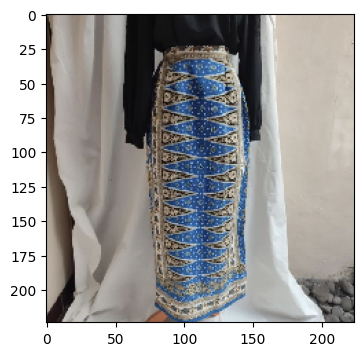

I see Batik Tumpal - confidence: 100.00% (True)


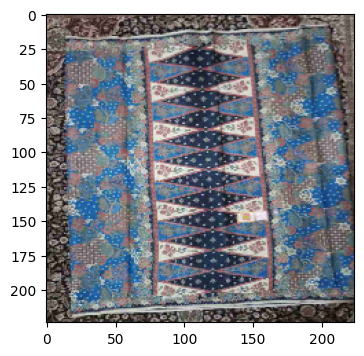

I see Batik Tumpal - confidence: 99.99% (True)


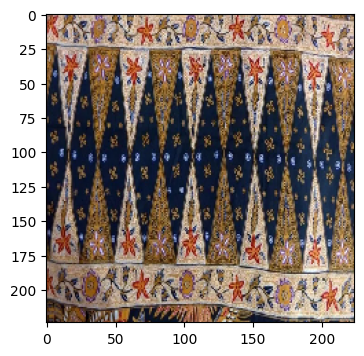

I see Batik Tumpal - confidence: 100.00% (True)


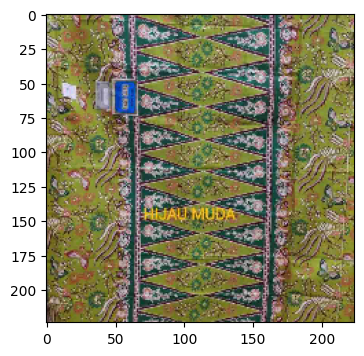

I see Batik Tumpal - confidence: 100.00% (True)


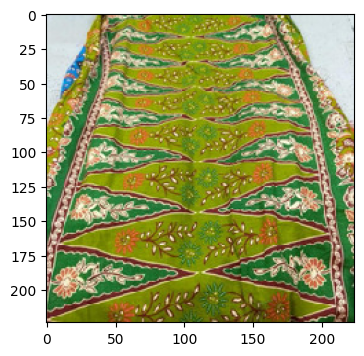

I see Batik Tumpal - confidence: 100.00% (True)


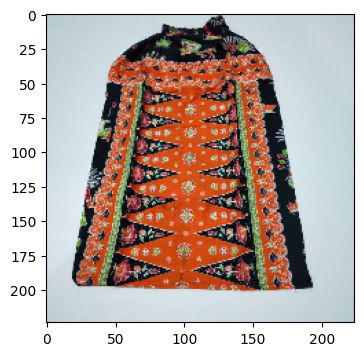

I see Batik Tumpal - confidence: 99.35% (True)


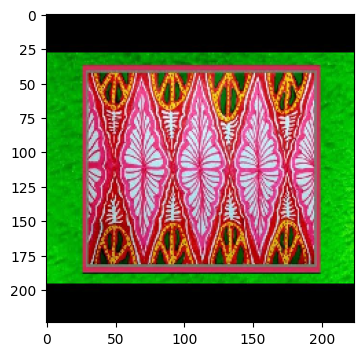

I see Batik Tumpal - confidence: 63.57% (True)


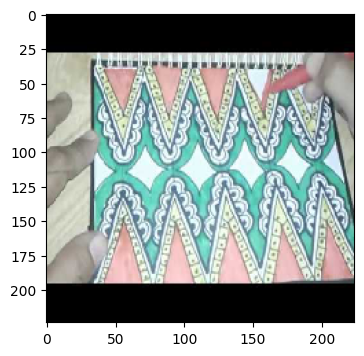

I see Batik Tumpal - confidence: 100.00% (True)


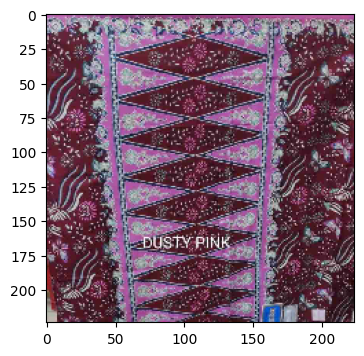

I see Batik Tumpal - confidence: 99.98% (True)


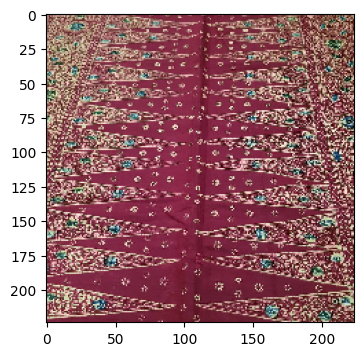

I see Batik Tumpal - confidence: 100.00% (True)


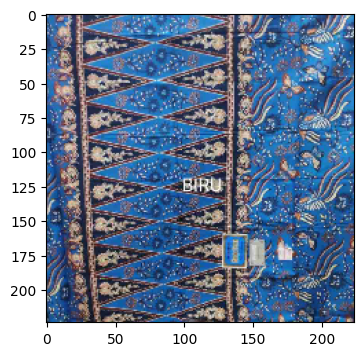

I see Batik Tumpal - confidence: 85.82% (True)


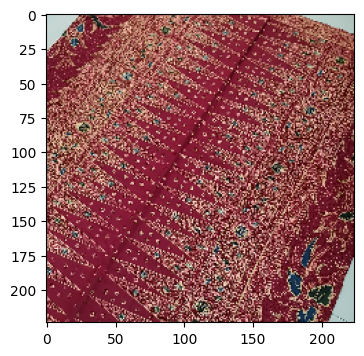

I see Batik Tumpal - confidence: 100.00% (True)


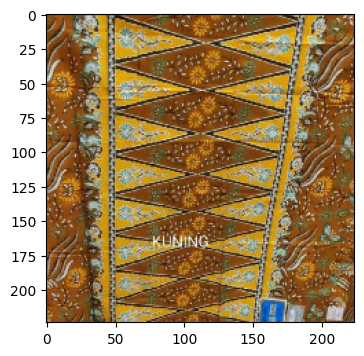

I see Batik Sidoluhur - confidence: 46.78% (False)


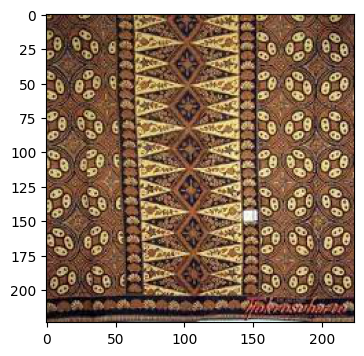

-----------------------------------------------------------
Finish testing model
Summary:
Batik Insang Predictions --> 18/20 correct
Batik Kawung Predictions --> 17/20 correct
Batik Mega mendung Predictions --> 18/20 correct
Batik Parang Predictions --> 15/20 correct
Batik Sidoluhur Predictions --> 17/20 correct
Batik Truntum Predictions --> 9/20 correct
Batik Tumpal Predictions --> 19/20 correct



In [ ]:
y_true, y_pred = test_model(imported_model)

## Confusion Matrix

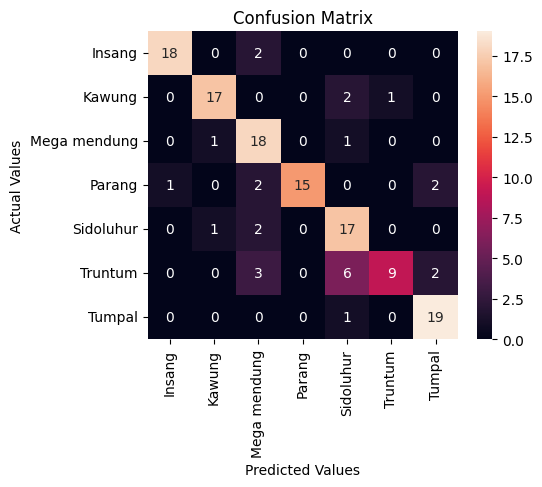

In [ ]:
cm = confusion_matrix(y_true, y_pred, labels=motives_list)
cm_df = pd.DataFrame(cm, index = motives_list, columns = motives_list)

plt.figure(figsize=(5,4))
sns.heatmap(cm_df, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()